# Contents
* [Introduction](#Introduction)
* [Imports and configuration](#Imports-and-configuration)
* [Setup](#Setup)
* [Transformations and visualization](#Transformations-and-visualization)
* [Coordinate conversion](#Coordinate-conversion)
* [Discussion](#Discussion)

# Introduction

To speed development, 5-fold train-test splits were preprocessed and prepared as separate .feather files and several new features extracted per fold. This notebook considers whether transforming certain pairs/triplets of features to their polar/spherical equivalents respectively is a useful tactic for feature engineering.

In [1]:
from time import time

notebook_begin_time = time()

# set random seeds

from os import environ
from random import seed as random_seed
from numpy.random import seed as np_seed
from tensorflow.random import set_seed


def reset_seeds(seed: int) -> None:
    """Utility function for resetting random seeds"""
    environ["PYTHONHASHSEED"] = str(seed)
    random_seed(seed)
    np_seed(seed)
    set_seed(seed)


reset_seeds(SEED := 2021)
del environ
del random_seed
del np_seed
del set_seed
del reset_seeds

In [2]:
# extensions
%load_ext autotime
%load_ext lab_black
%load_ext nb_black

In [3]:
# core
import numpy as np
import pandas as pd

# utility
from gc import collect as gc_collect

# faster sklearn
from sklearnex import patch_sklearn

patch_sklearn()
del patch_sklearn
import sklearn

# typing
from sklearn.base import BaseEstimator
from typing import Tuple

# coordinate conversion & feature engineering
from numpy import arctan2, hypot
from sklearn.feature_selection import SelectFromModel
from sklearn.preprocessing import PowerTransformer, QuantileTransformer, StandardScaler

# classifiers
from sklearn.calibration import CalibratedClassifierCV
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import (
    AdaBoostClassifier,
    ExtraTreesClassifier,
    RandomForestClassifier,
    VotingClassifier,
)
from sklearn.linear_model import (
    LogisticRegression,
    RidgeClassifier,
    PassiveAggressiveClassifier,
    SGDClassifier,
)
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import LinearSVC, SVC

# metrics
from imblearn.metrics import geometric_mean_score
from sklearn.metrics import (
    accuracy_score,
    balanced_accuracy_score,
    f1_score,
    roc_auc_score,
)

# visualization
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_context("notebook")
%matplotlib inline

# display outputs w/o print calls
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"
del InteractiveShell

# hide warnings
import warnings

# warnings.filterwarnings("ignore")
del warnings

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


time: 2.95 s


In [4]:
# Location of CV .feather files
CV_FEATHERS_FOLDER = "../10.0-mic-prepare_train-test_splits_on_full_data"

_ = gc_collect()

time: 95.8 ms


# Setup

In [5]:
def read_data(train_or_test: str, fold_num: int = 0) -> Tuple[pd.DataFrame, pd.Series]:
    """Read labels and FRILL-derived features"""
    read_feather = lambda filename: pd.read_feather(
        f"{CV_FEATHERS_FOLDER}/cv_{fold_num}/{filename}.feather"
    )
    x_prefix = f"X_{train_or_test}"
    return (
        pd.concat(
            [
                read_feather(f"{x_prefix}_LDA"),
                read_feather(f"{x_prefix}_LDA-LOF_scores"),
                read_feather(f"{x_prefix}_LOF_scores"),
                *[
                    read_feather(f"{x_prefix}_OC_{kernel}")
                    for kernel in ("rbf", "sgdlinear", "sigmoid")
                ],
                *[read_feather(f"{x_prefix}_OC_poly{deg}") for deg in range(2, 6)],
            ],
            axis="columns",
        ),
        read_feather(f"y_{train_or_test}_untransformed").iloc[:, 0],
    )


_ = gc_collect()

time: 122 ms


In [6]:
results = {
    key: []
    for key in (
        "features",
        "model",
        "accuracy",
        "adjusted balanced accuracy",
        "F1 weighted",
        "geometric mean",
        "AUROC",
    )
}


def get_scores(
    features: str,
    model: BaseEstimator,
    X_train: pd.DataFrame,
    y_train: pd.Series,
    X_test: pd.DataFrame,
    y_test: pd.Series,
) -> BaseEstimator:
    """Calculate and print scores and return the fitted estimator"""
    try:
        X_train = X_train.values
        X_test = X_test.values
    except AttributeError:
        pass
    model = model.fit(X_train, y_train)
    args = (y_test, model.predict(X_test))
    print(model)
    print("accuracy:", _ := accuracy_score(*args))
    results["accuracy"].append(_)
    print("balanced_accuracy:", _ := balanced_accuracy_score(*args, adjusted=True))
    results["adjusted balanced accuracy"].append(_)
    print("f1_weighted:", _ := f1_score(*args, average="weighted"))
    results["F1 weighted"].append(_)
    print("geometric_mean:", _ := geometric_mean_score(*args))
    results["geometric mean"].append(_)
    predicted_proba = model.predict_proba(X_test)
    print(
        "auroc:",
        _ := roc_auc_score(
            y_test,
            predicted_proba,
            average="weighted",
            multi_class="ovo",
        ),
    )
    results["AUROC"].append(_)
    results["model"].append(str(model))
    results["features"].append(features)
    return model


def score_models(
    X_train: pd.DataFrame,
    y_train: pd.Series,
    X_test: pd.DataFrame,
    y_test: pd.Series,
    features: str = "",
    select_features=False,
) -> None:
    """Evaluate models given data"""
    for model in (
        GaussianNB(),
        LogisticRegression(random_state=SEED, n_jobs=-1),
        CalibratedClassifierCV(
            base_estimator=RidgeClassifier(random_state=SEED), n_jobs=-1
        ),
        CalibratedClassifierCV(base_estimator=SVC(random_state=SEED), n_jobs=-1),
        RandomForestClassifier(n_jobs=-1, random_state=SEED),
        VotingClassifier(
            estimators=[
                ("GNB", CalibratedClassifierCV(base_estimator=GaussianNB(), n_jobs=-1)),
                (
                    "RF",
                    CalibratedClassifierCV(
                        base_estimator=RandomForestClassifier(
                            n_jobs=-1, random_state=SEED
                        ),
                        n_jobs=-1,
                    ),
                ),
            ],
            voting="soft",
            n_jobs=-1,
            verbose=True,
        ),
        VotingClassifier(
            estimators=[
                ("GNB", CalibratedClassifierCV(base_estimator=GaussianNB(), n_jobs=-1)),
                (
                    "Ridge",
                    CalibratedClassifierCV(
                        base_estimator=RidgeClassifier(random_state=SEED), n_jobs=-1
                    ),
                ),
            ],
            voting="soft",
            n_jobs=-1,
            verbose=True,
        ),
    ):
        fitted_model = get_scores(features, model, X_train, y_train, X_test, y_test)
        if select_features:
            try:
                X_train = X_train.values
                X_test = X_test.values
            except AttributeError:
                pass
            try:
                feature_filter = SelectFromModel(estimator=fitted_model, prefit=True)
                X_train = feature_filter.transform(X_train)
                X_test = feature_filter.transform(X_test)
            except (AttributeError, ValueError):
                if hasattr(fitted_model, "estimators_"):
                    estimator = (
                        RidgeClassifier(random_state=SEED)
                        if "Ridge" in str(fitted_model.estimators_)
                        else RandomForestClassifier(n_jobs=-1, random_state=SEED)
                    )
                else:
                    estimator = ExtraTreesClassifier(n_jobs=-1, random_state=SEED)
                feature_filter = SelectFromModel(
                    estimator=estimator
                    # estimator=RandomForestClassifier(n_jobs=-1, random_state=SEED)
                    # estimator=LinearDiscriminantAnalysis()
                    # estimator=SGDClassifier(n_jobs=-1, random_state=SEED)
                    # estimator=LinearSVC(random_state=SEED)
                    # estimator=ExtraTreesClassifier(n_jobs=-1, random_state=SEED)
                    # estimator=RidgeClassifier(random_state=SEED)
                    # estimator=PassiveAggressiveClassifer(n_jobs=-1, random_state=SEED)
                    # estimator=AdaBoostClassifier(random_state=SEED)
                ).fit(X_train, y_train)
                X_train = feature_filter.transform(X_train)
                X_test = feature_filter.transform(X_test)
            get_scores(f"selected_{features}", model, X_train, y_train, X_test, y_test)


_ = gc_collect()

time: 95.7 ms


In [7]:
def plot2d(
    col1: str,
    col2: str,
    X_train: pd.DataFrame,
    y_train: pd.Series,
    X_test: pd.DataFrame,
    y_test: pd.Series,
    suptitle: str = "",
) -> None:
    """Plot 2D scatterplot"""
    _, ax = plt.subplots(1, 2)
    plot_params = {
        "x": col1,
        "y": col2,
        "palette": "viridis",
        "hue_order": [0, 1, 2],
        "alpha": 0.25,
        "legend": False,
        "linewidth": 0,
        "marker": ".",
        "s": 50,
    }
    sns.scatterplot(
        hue=y_train,
        data=X_train,
        ax=ax[0],
        **plot_params,
    )
    ax[0].set_xlabel("")
    ax[0].set_ylabel("")
    sns.scatterplot(
        hue=y_test,
        data=X_test,
        ax=ax[1],
        **plot_params,
    )
    ax[1].set_xlabel("")
    ax[1].set_ylabel("")
    plt.suptitle(f"{suptitle}: {col1} and {col2}")
    sns.despine(**dict.fromkeys(("top", "right"), True))
    plt.show()


def plot3d(
    col1: str,
    col2: str,
    col3: str,
    X_train: pd.DataFrame,
    y_train: pd.Series,
    X_test: pd.DataFrame,
    y_test: pd.Series,
    suptitle: str = "",
) -> None:
    fig = plt.figure(figsize=(10, 5))
    ax = fig.add_subplot(121, projection="3d")
    ax.scatter(
        X_train[col1],
        X_train[col2],
        X_train[col3],
        alpha=0.25,
        linewidth=0,
        cmap="viridis",
        c=y_train,
    )
    ax = fig.add_subplot(122, projection="3d")
    ax.scatter(
        X_test[col1],
        X_test[col2],
        X_test[col3],
        alpha=0.25,
        linewidth=0,
        cmap="viridis",
        c=y_test,
    )
    _ = gc_collect()
    plt.suptitle(f"{suptitle}: {col1},  {col2}, {col3}")
    plt.show()


_ = gc_collect()

time: 90.1 ms


In [8]:
VALENCES = ("neg", "neu", "pos")
KERNELS = ("rbf", "sgdlinear", "sigmoid")
POLYS = (2, 3, 4, 5)
NEIGHBORS = (10, 20, 30)


doubles = (
    ["LDA1", "LDA2"],
    *[[f"{kernel}_LDA1", f"{kernel}_LDA2"] for kernel in KERNELS],
    *[[f"poly{deg}_LDA1", f"poly{deg}_LDA2"] for deg in POLYS],
)

triples = (
    *[
        [f"LDA-LOF_{valence}_{n_neighbors}" for valence in VALENCES]
        for n_neighbors in NEIGHBORS
    ],
    *[
        [f"LOF_{valence}_{n_neighbors}" for valence in VALENCES]
        for n_neighbors in NEIGHBORS
    ],
    *[[f"ocsvm_{kernel}_{valence}" for valence in VALENCES] for kernel in KERNELS],
    *[[f"ocsvm_poly{deg}_{valence}" for valence in VALENCES] for deg in POLYS],
    *[[f"LDA_{kernel}_{valence}" for valence in VALENCES] for kernel in KERNELS],
    *[[f"LDA_poly{deg}_{valence}" for valence in VALENCES] for deg in POLYS],
)

_ = gc_collect()

time: 92.1 ms


# Transformations and visualization

Before transformation:

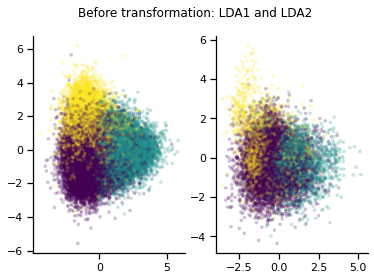

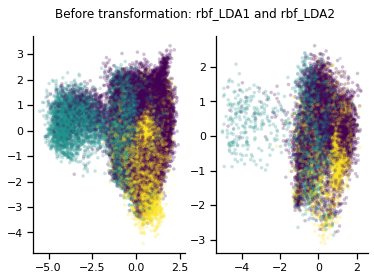

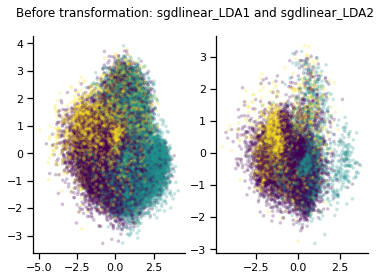

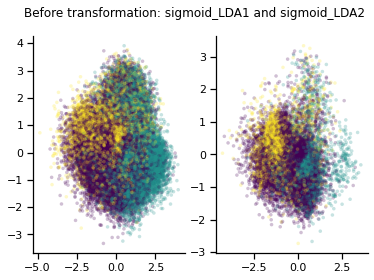

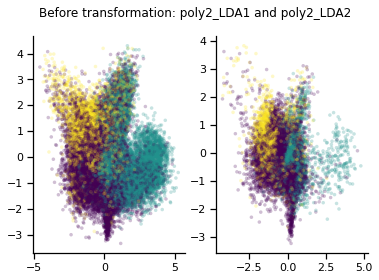

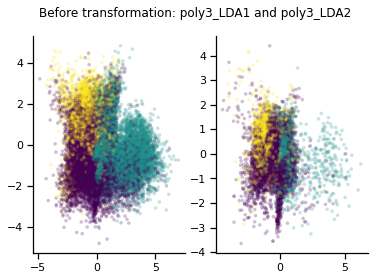

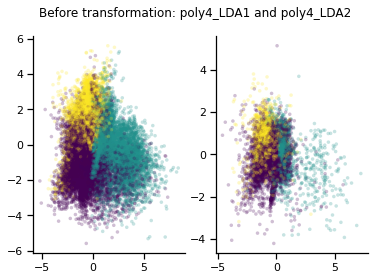

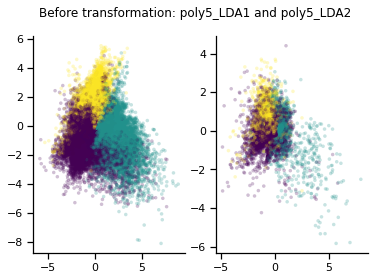

time: 7.09 s


In [9]:
X_train, y_train = read_data("train")
X_test, y_test = read_data("test")
for col1, col2 in doubles:
    plot2d(
        col1, col2, X_train, y_train, X_test, y_test, suptitle="Before transformation"
    )

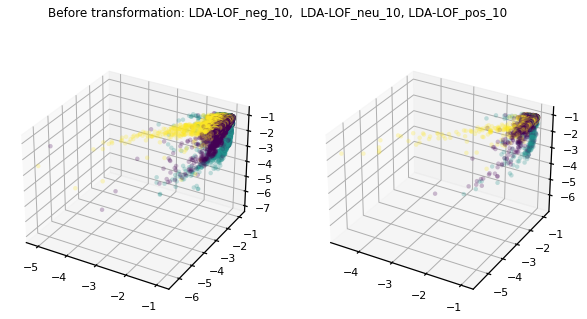

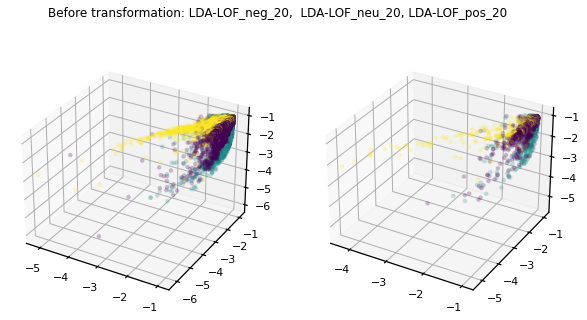

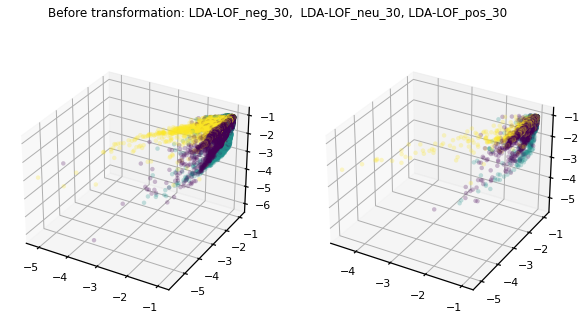

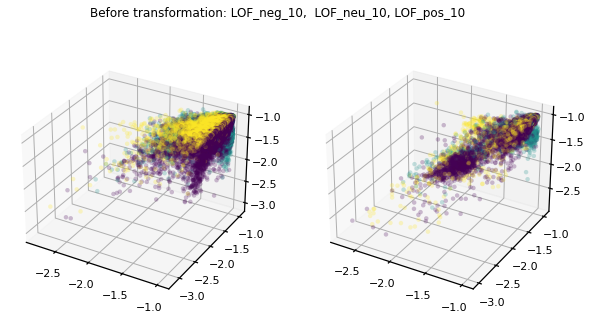

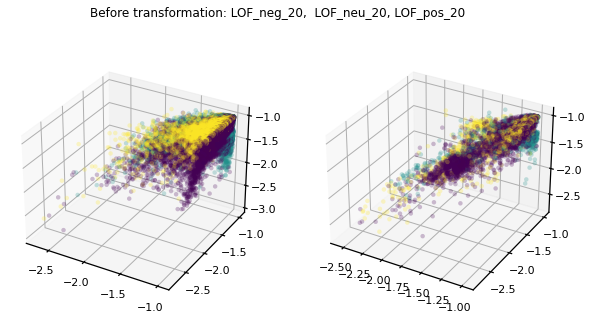

...

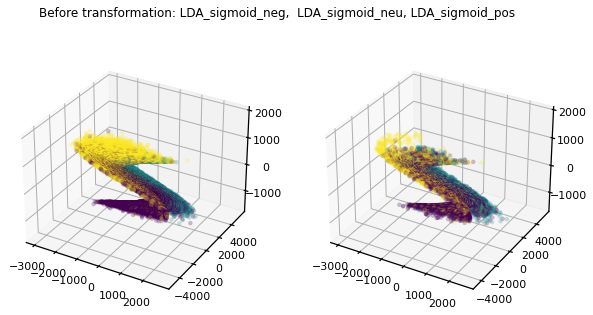

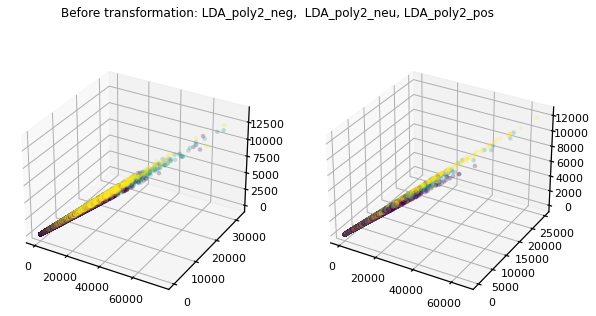

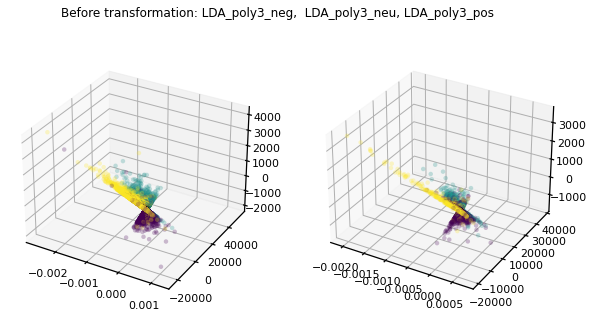

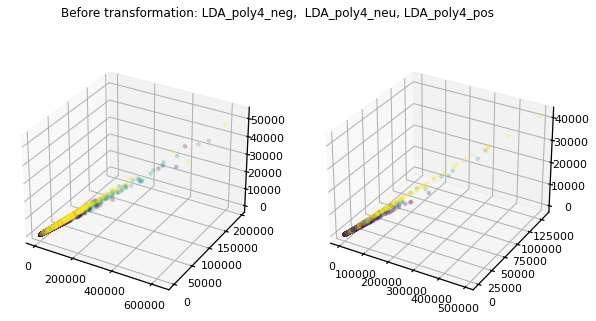

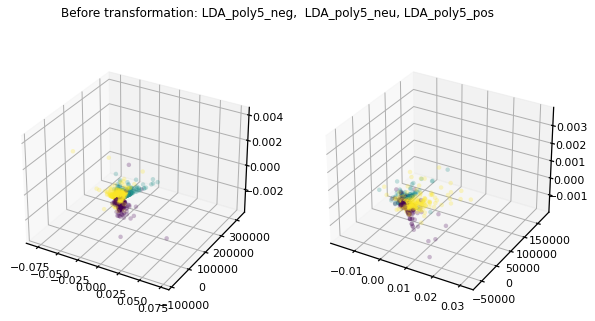

time: 23.6 s


In [10]:
for col1, col2, col3 in triples:
    plot3d(
        col1,
        col2,
        col3,
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="Before transformation",
    )

Performance benchmark

In [11]:
score_models(
    X_train, y_train, X_test, y_test, features="no transforms", select_features=True
)

GaussianNB()
accuracy: 0.6313917296576256
balanced_accuracy: 0.23665390690727175
f1_weighted: 0.5967478047199439
geometric_mean: 0.4267490208237378
auroc: 0.748253715448872
GaussianNB()
accuracy: 0.6270935230472803
balanced_accuracy: 0.3710486108059207
f1_weighted: 0.6272887723316092
geometric_mean: 0.5701314118775161
auroc: 0.7701793380272546


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6355417222469245
balanced_accuracy: 0.3050259466314325
f1_weighted: 0.6172596715944125
geometric_mean: 0.493244236875988
auroc: 0.7567172906726678


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6333926189417519
balanced_accuracy: 0.300204042835912
f1_weighted: 0.6148784121821617
geometric_mean: 0.4892435195923569
auroc: 0.7551523253440228
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6464354527938343
balanced_accuracy: 0.33375694552868646
f1_weighted: 0.6287345180968537
geometric_mean: 0.5097952141101455
auroc: 0.766352566628263
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.631910478731288
balanced_accuracy: 0.28856236534713897
f1_weighted: 0.5983883173361089
geometric_mean: 0.42701077604230997
auroc: 0.7494494950806769
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.6260560248999555
balanced_accuracy: 0.22570767959410956
f1_weighted: 0.548791534773605
geometric_mean: 0.0
auroc: 0.6973929246992978
CalibratedClassifierCV(base_estimator=

Transform columns

In [12]:
power_transformer = PowerTransformer().fit(X_train)
feature_names = X_train.columns
X_train = pd.DataFrame(power_transformer.transform(X_train))
X_train.columns = feature_names
X_test = pd.DataFrame(power_transformer.transform(X_test))
X_test.columns = feature_names
del feature_names
del power_transformer
_ = gc_collect()

time: 9.78 s


After Yeo-Johnson transformation + standardization (enabled by default):

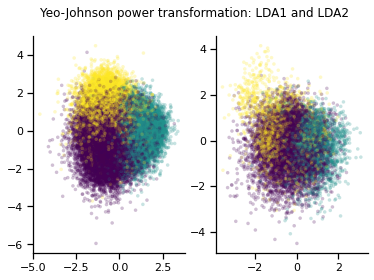

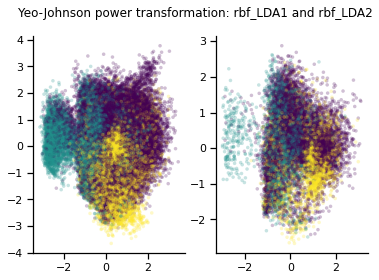

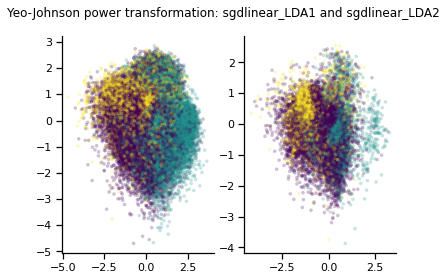

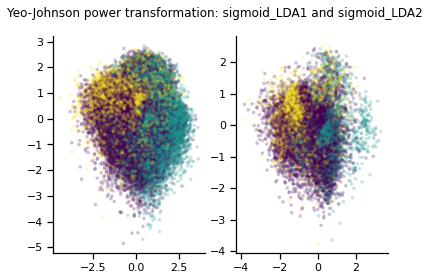

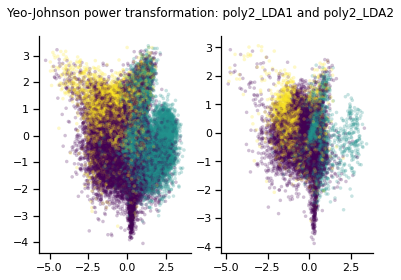

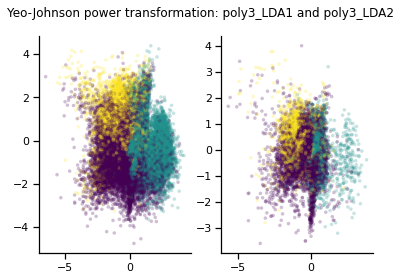

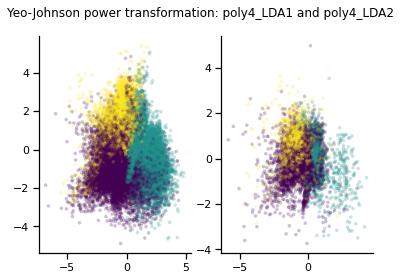

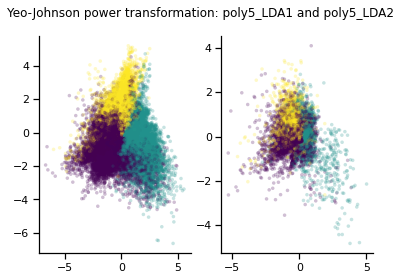

time: 6.76 s


In [13]:
for col1, col2 in doubles:
    plot2d(
        col1,
        col2,
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="Yeo-Johnson power transformation",
    )

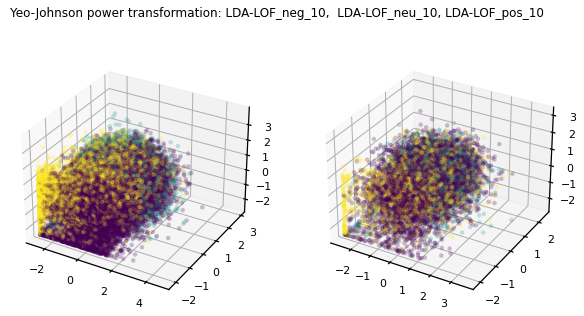

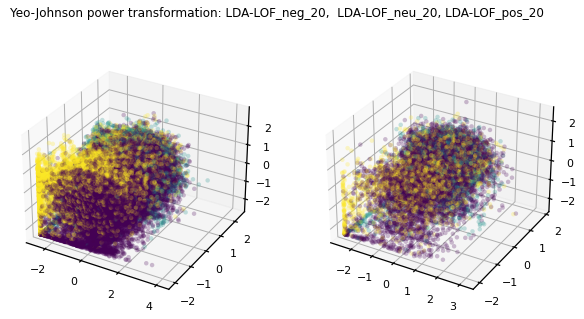

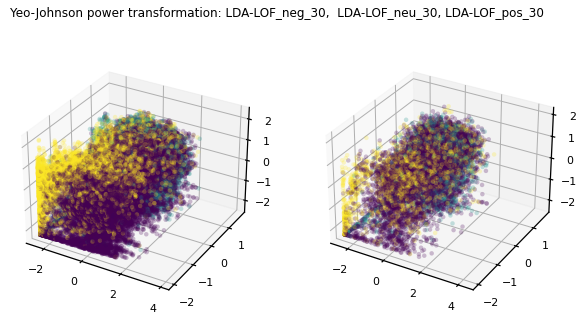

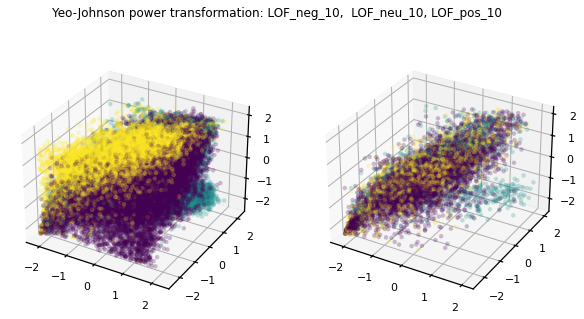

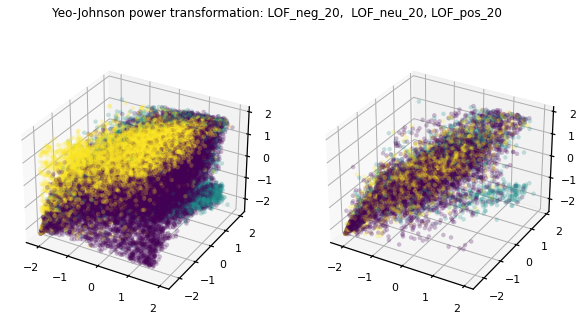

...

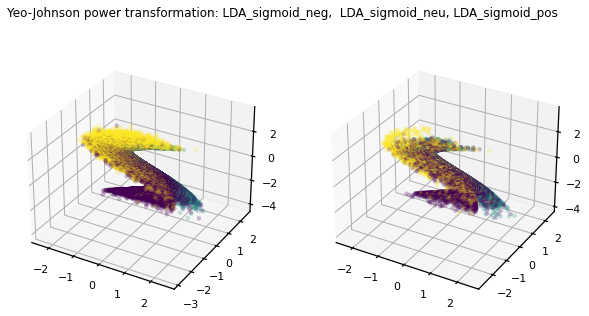

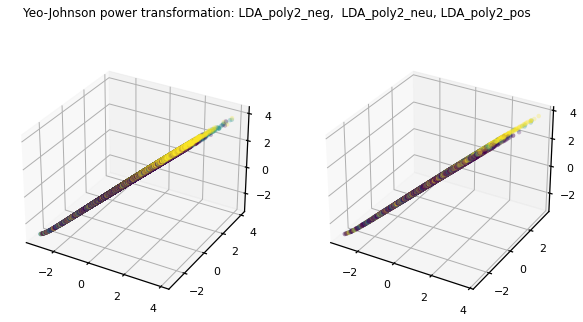

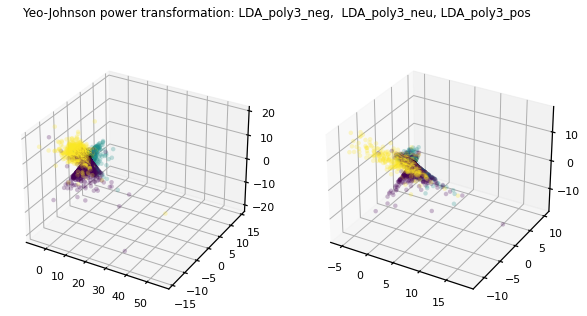

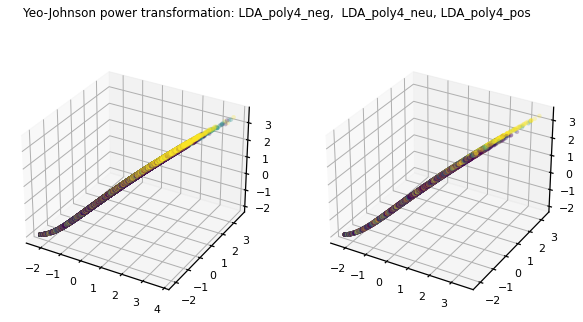

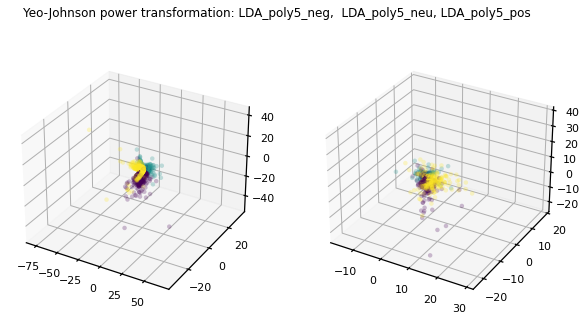

time: 22.2 s


In [14]:
for col1, col2, col3 in triples:
    plot3d(
        col1,
        col2,
        col3,
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="Yeo-Johnson power transformation",
    )

Performance benchmark

In [15]:
score_models(X_train, y_train, X_test, y_test, features="YJ-std", select_features=True)

GaussianNB()
accuracy: 0.6279828071735586
balanced_accuracy: 0.33557440623570384
f1_weighted: 0.6196927921199264
geometric_mean: 0.5317238554271049
auroc: 0.761509535541956
GaussianNB()
accuracy: 0.6161997925003705
balanced_accuracy: 0.3845585983455582
f1_weighted: 0.6172803346483121
geometric_mean: 0.5762812078193412
auroc: 0.7709017051662485


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6218319253001334
balanced_accuracy: 0.2882479594220803
f1_weighted: 0.6003168227524929
geometric_mean: 0.4680372954222626
auroc: 0.7478691537931219


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.5925596561434712
balanced_accuracy: 0.20905654529845108
f1_weighted: 0.5614255888350822
geometric_mean: 0.39615108553101325
auroc: 0.7107145141627547
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.606862309174448
balanced_accuracy: 0.2178418148255539
f1_weighted: 0.570809891090961
geometric_mean: 0.39264767263736017
auroc: 0.7159764177576919
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6229435304579813
balanced_accuracy: 0.1776029138692642
f1_weighted: 0.5382149649728867
geometric_mean: 0.0
auroc: 0.6831949255221409
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.6215354972580406
balanced_accuracy: 0.2224137272925488
f1_weighted: 0.5450949368540556
geometric_mean: 0.0
auroc: 0.6978563009082853
CalibratedClassifierCV(base_estimator=SVC(random_sta

Copied and pasted from above for reference:

Untransformed:
* GaussianNB()
  * accuracy: 0.6313917296576256
  * balanced_accuracy: 0.23665390690727175
  * f1_weighted: 0.5967478047199439
  * geometric_mean: 0.4267490208237378
  * auroc: 0.748253715448872
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6380613606047132
  * balanced_accuracy: 0.31155357350482027
  * f1_weighted: 0.6187821893238297
  * geometric_mean: 0.4935924357745123
  * auroc: 0.7575364007939785
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6490291981621461
  * balanced_accuracy: 0.333935968248291
  * f1_weighted: 0.6293224816609382
  * geometric_mean: 0.5051782933513195
  * auroc: 0.7535351670022706
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6495479472358086
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643761335084176

Yeo-Johnson + standardization:
* GaussianNB()
  * accuracy: 0.6279828071735586
  * balanced_accuracy: 0.33557440623570384
  * f1_weighted: 0.6196927921199264
  * geometric_mean: 0.5317238554271049
  * auroc: 0.761509535541956
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6378390395731436
  * balanced_accuracy: 0.3032168191448733
  * f1_weighted: 0.6132576883786681
  * geometric_mean: 0.4718492604944274
  * auroc: 0.7540975712505336
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6485104490884838
  * balanced_accuracy: 0.3260213584413257
  * f1_weighted: 0.6280982133193316
  * geometric_mean: 0.5003371788269403
  * auroc: 0.7542472903268659
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6473988439306358
  * balanced_accuracy: 0.27211697371593035
  * f1_weighted: 0.6096949010482753
  * geometric_mean: 0.4291473364989096
  * auroc: 0.7638133094910748

The power transformation improved performance for most metrics. GaussianNB displayed the most drastic improvement in performance, although accuracy suffered some. LogisticRegression performed more poorly after transformation. Ridge performed more poorly too except for a tiny boost in AUROC.

Let's try that again with the QuantileTransformer instead.

In [16]:
# reset
X_train, y_train = read_data("train")
X_test, y_test = read_data("test")

time: 275 ms


Transform columns

In [17]:
quantile_transformer = QuantileTransformer(
    output_distribution="normal", random_state=SEED
).fit(X_train)
feature_names = X_train.columns
X_train = pd.DataFrame(quantile_transformer.transform(X_train))
X_train.columns = feature_names
X_test = pd.DataFrame(quantile_transformer.transform(X_test))
X_test.columns = feature_names
del feature_names
del quantile_transformer
_ = gc_collect()

time: 2.65 s


After quantile transformation to normal distribution:

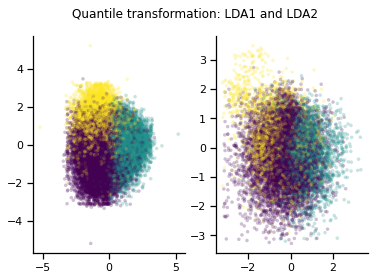

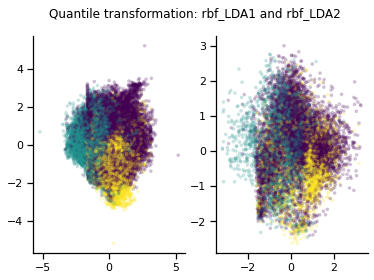

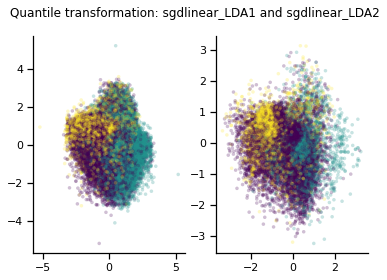

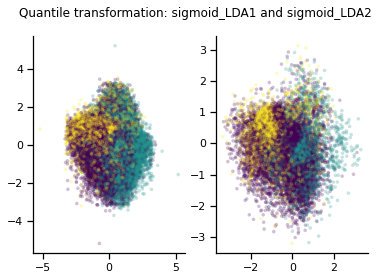

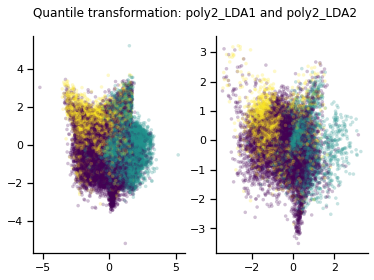

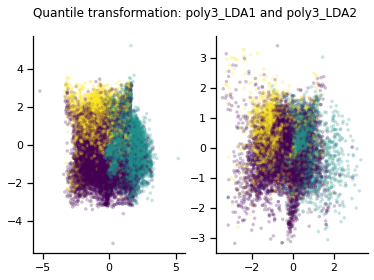

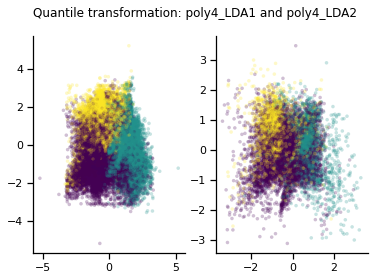

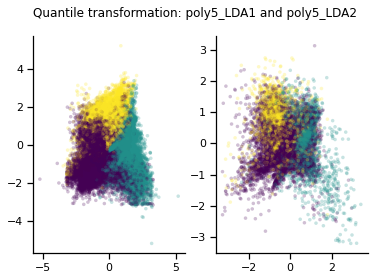

time: 6.59 s


In [18]:
for col1, col2 in doubles:
    plot2d(
        col1,
        col2,
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="Quantile transformation",
    )

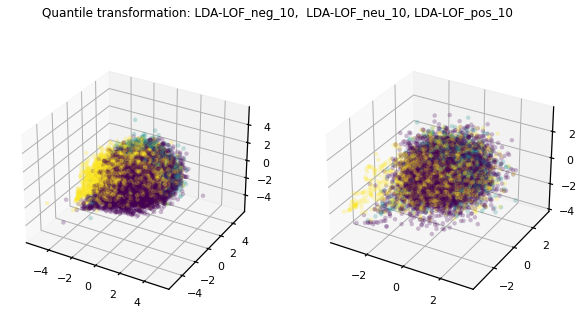

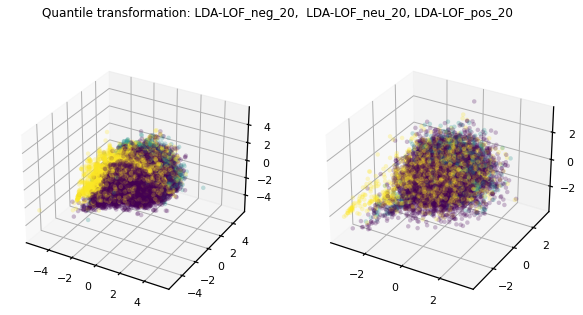

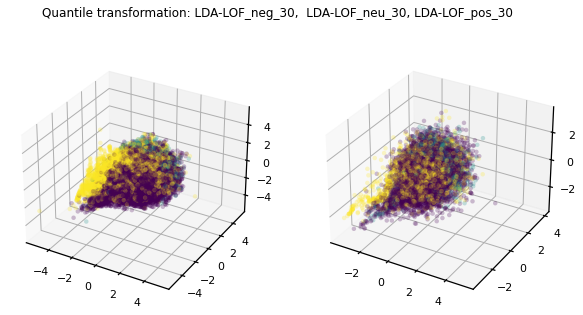

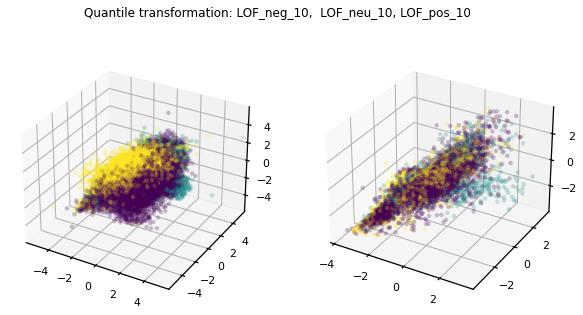

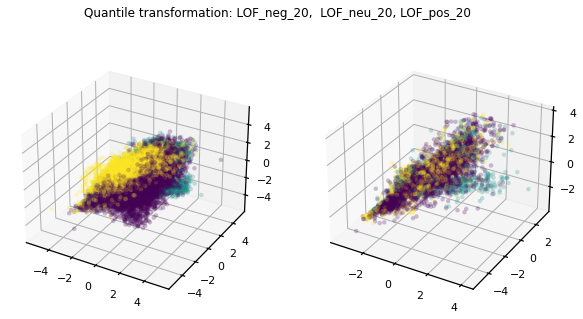

...

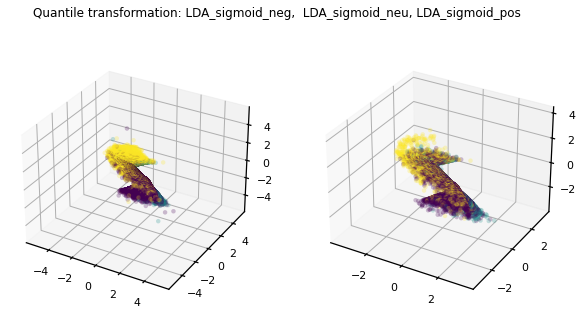

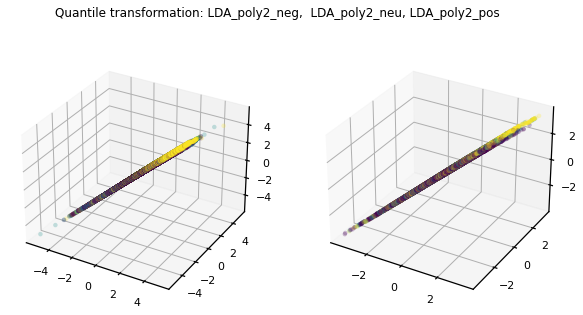

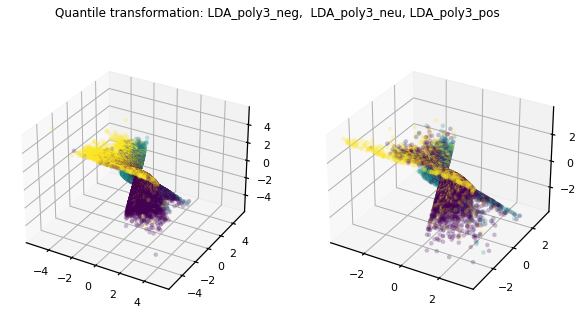

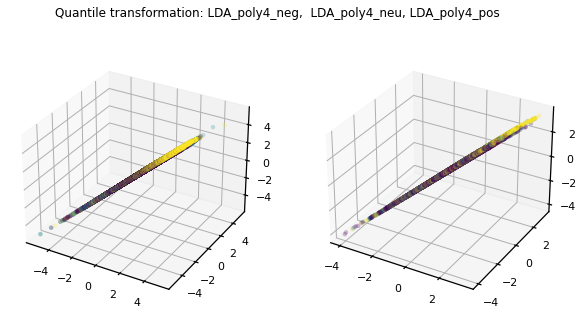

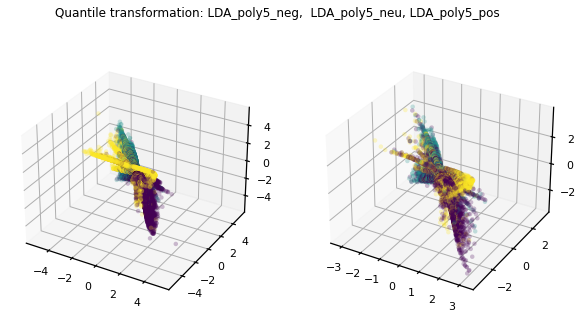

time: 22.5 s


In [19]:
for col1, col2, col3 in triples:
    plot3d(
        col1,
        col2,
        col3,
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="Quantile transformation",
    )

Performance benchmark

In [20]:
score_models(X_train, y_train, X_test, y_test, features="QT", select_features=True)

GaussianNB()
accuracy: 0.6161997925003705
balanced_accuracy: 0.3807113697404689
f1_weighted: 0.6188166624329459
geometric_mean: 0.5793319249372495
auroc: 0.7689886260571416
GaussianNB()
accuracy: 0.624351563657922
balanced_accuracy: 0.3926047518692427
f1_weighted: 0.625096331184905
geometric_mean: 0.5823427778586451
auroc: 0.7722570739193835


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6397658218467467
balanced_accuracy: 0.29308591792220656
f1_weighted: 0.6070552167297678
geometric_mean: 0.4393154684512249
auroc: 0.7476061767481479


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6073810582481103
balanced_accuracy: 0.2079880467943894
f1_weighted: 0.5680477514701597
geometric_mean: 0.3776112290985222
auroc: 0.7212825046063998
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6094560545427598
balanced_accuracy: 0.2145238985411885
f1_weighted: 0.5669198910600892
geometric_mean: 0.35848527398383523
auroc: 0.7141097835569399
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6301319104787313
balanced_accuracy: 0.28118943454897666
f1_weighted: 0.6030841955607655
geometric_mean: 0.4489901245828684
auroc: 0.7397361070834432
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.6150881873425226
balanced_accuracy: 0.27177048385193076
f1_weighted: 0.5925113845679383
geometric_mean: 0.44688206324944063
auroc: 0.7093920636576445
CalibratedClassifie

Copied and pasted from above for reference:

Untransformed:
* GaussianNB()
  * accuracy: 0.6313917296576256
  * balanced_accuracy: 0.23665390690727175
  * f1_weighted: 0.5967478047199439
  * geometric_mean: 0.4267490208237378
  * auroc: 0.748253715448872
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6380613606047132
  * balanced_accuracy: 0.31155357350482027
  * f1_weighted: 0.6187821893238297
  * geometric_mean: 0.4935924357745123
  * auroc: 0.7575364007939785
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6490291981621461
  * balanced_accuracy: 0.333935968248291
  * f1_weighted: 0.6293224816609382
  * geometric_mean: 0.5051782933513195
  * auroc: 0.7535351670022706
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6495479472358086
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643761335084176

Yeo-Johnson + standardization:
* GaussianNB()
  * accuracy: 0.6279828071735586
  * balanced_accuracy: 0.33557440623570384
  * f1_weighted: 0.6196927921199264
  * geometric_mean: 0.5317238554271049
  * auroc: 0.761509535541956
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6378390395731436
  * balanced_accuracy: 0.3032168191448733
  * f1_weighted: 0.6132576883786681
  * geometric_mean: 0.4718492604944274
  * auroc: 0.7540975712505336
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6485104490884838
  * balanced_accuracy: 0.3260213584413257
  * f1_weighted: 0.6280982133193316
  * geometric_mean: 0.5003371788269403
  * auroc: 0.7542472903268659
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6473988439306358
  * balanced_accuracy: 0.27211697371593035
  * f1_weighted: 0.6096949010482753
  * geometric_mean: 0.4291473364989096
  * auroc: 0.7638133094910748

Quantile transformation:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * balanced_accuracy: 0.3807113697404689
  * f1_weighted: 0.6188166624329459
  * geometric_mean: 0.5793319249372495
  * auroc: 0.7689886260571416
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6362086853416333
  * balanced_accuracy: 0.3111206991081969
  * f1_weighted: 0.6137568454111832
  * geometric_mean: 0.4777317102111034
  * auroc: 0.7526013736609206
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462161025469437
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6495479472358086
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643721514738875

Some classifiers may perform better with different transformations. GaussianNB especially gains performance boost from quantile transformation, but its accuracy is highest on the untransformed data. LogReg attains worse AUROC with this transformation, which is highest on the untransformed data; for other metrics, quantile transformation is superior, but the untransformed data yields best performance so far. Ridge attains roughly equivalent scores between transformations, but the untransformed data yields best performance so far as well.

Should this transformation be standardized too?

In [21]:
std_scaler = StandardScaler().fit(X_train)
feature_names = X_train.columns
X_train = pd.DataFrame(std_scaler.transform(X_train))
X_train.columns = feature_names
X_test = pd.DataFrame(std_scaler.transform(X_test))
X_test.columns = feature_names
del feature_names
del std_scaler
_ = gc_collect()

time: 409 ms


After quantile transformation + standardization:

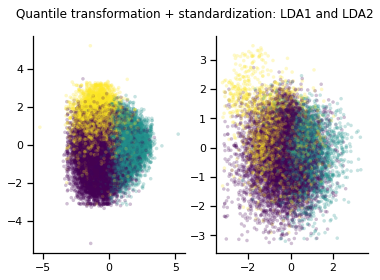

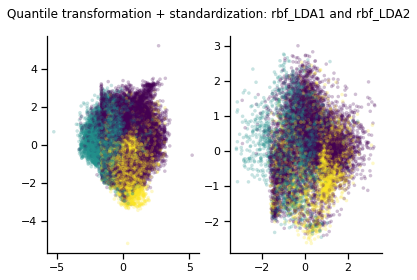

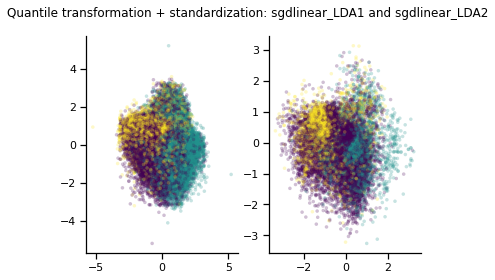

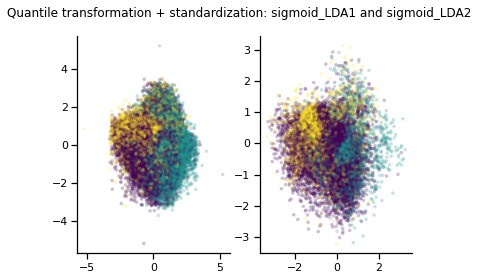

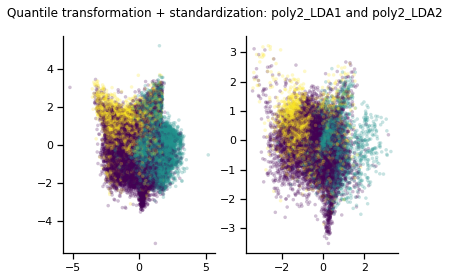

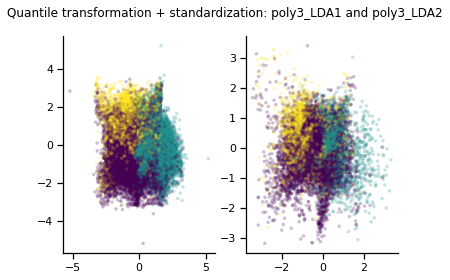

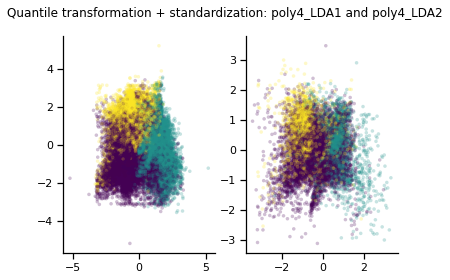

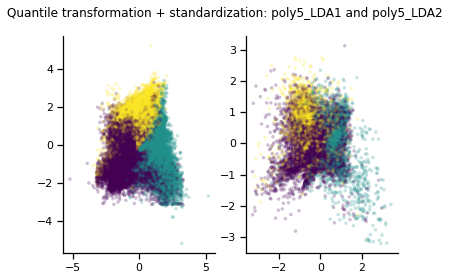

time: 6.33 s


In [22]:
for col1, col2 in doubles:
    plot2d(
        col1,
        col2,
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="Quantile transformation + standardization",
    )

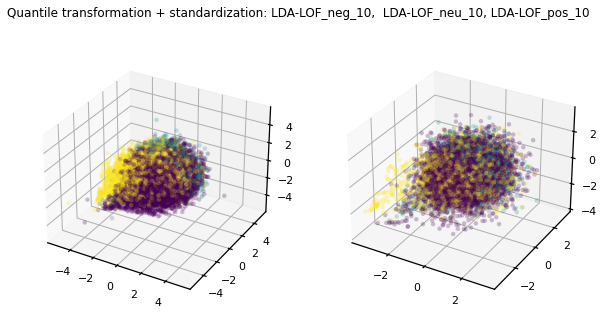

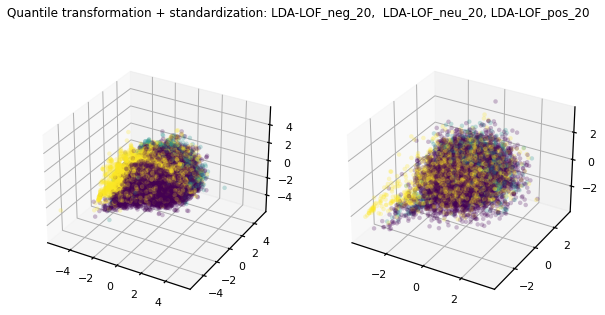

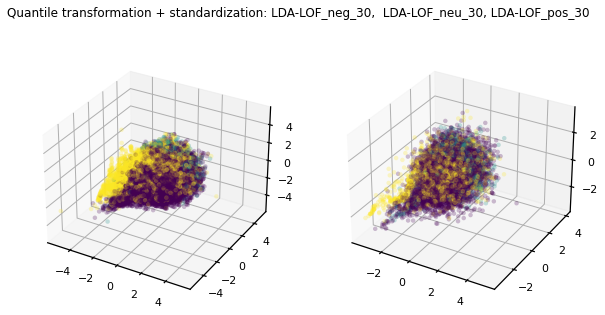

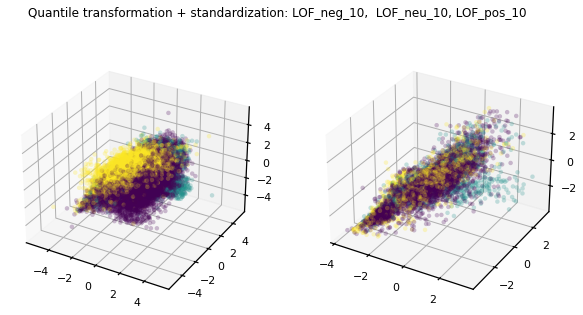

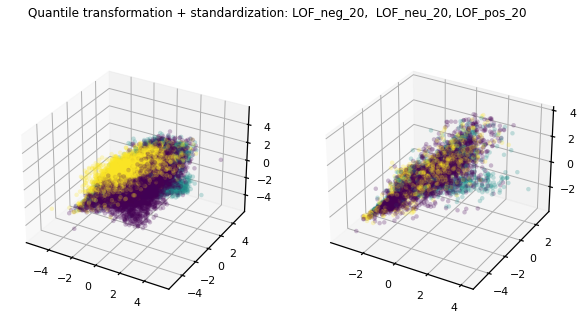

...

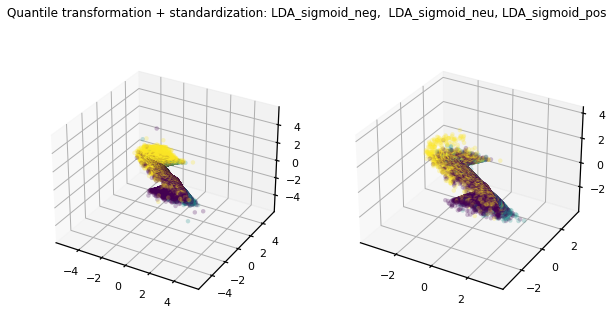

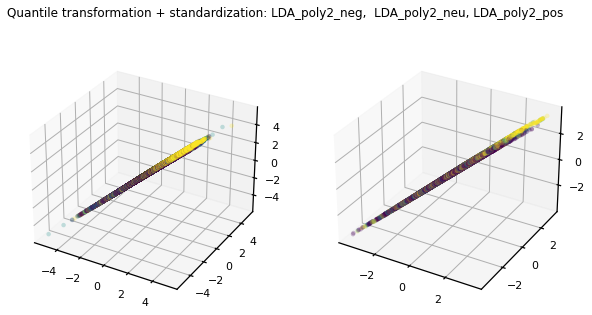

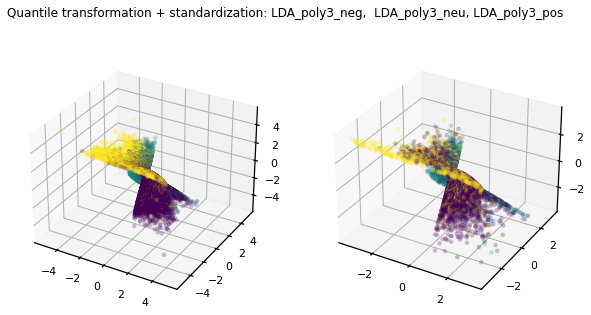

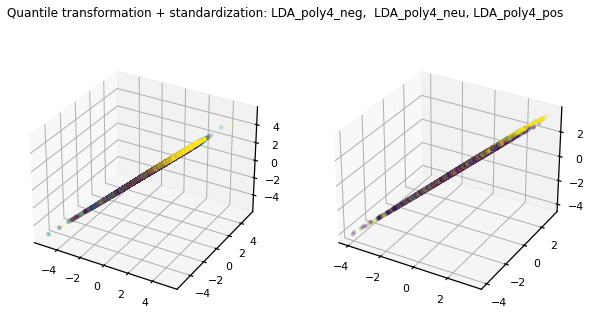

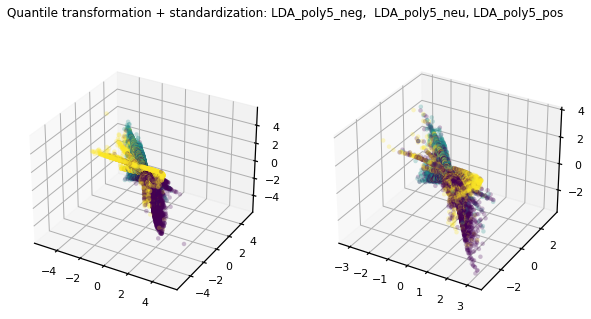

time: 21.2 s


In [23]:
for col1, col2, col3 in triples:
    plot3d(
        col1,
        col2,
        col3,
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="Quantile transformation + standardization",
    )

Performance benchmark

In [24]:
score_models(X_train, y_train, X_test, y_test, features="QT-std", select_features=True)

GaussianNB()
accuracy: 0.6161997925003705
balanced_accuracy: 0.3807113697404689
f1_weighted: 0.6188166624329459
geometric_mean: 0.5793319249372495
auroc: 0.7689886260571416
GaussianNB()
accuracy: 0.624351563657922
balanced_accuracy: 0.3926047518692427
f1_weighted: 0.625096331184905
geometric_mean: 0.5823427778586451
auroc: 0.7722570537928924


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6402104639098859
balanced_accuracy: 0.2945111757573553
f1_weighted: 0.6076082012973326
geometric_mean: 0.4402637529852374
auroc: 0.7486072394834913


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6073810582481103
balanced_accuracy: 0.2077595933069594
f1_weighted: 0.5679595516377833
geometric_mean: 0.3772486800259164
auroc: 0.7211545254432827
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6094560545427598
balanced_accuracy: 0.2145238985411885
f1_weighted: 0.5669198910600892
geometric_mean: 0.35848527398383523
auroc: 0.7141097583883647
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6301319104787313
balanced_accuracy: 0.28118943454897666
f1_weighted: 0.6030841955607655
geometric_mean: 0.4489901245828684
auroc: 0.7397361070834432
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.6150881873425226
balanced_accuracy: 0.27177048385193076
f1_weighted: 0.5925113845679383
geometric_mean: 0.44688206324944063
auroc: 0.7093919774774093
CalibratedClassifie

Copied and pasted from above for reference:

Untransformed:
* GaussianNB()
  * accuracy: 0.6313917296576256
  * balanced_accuracy: 0.23665390690727175
  * f1_weighted: 0.5967478047199439
  * geometric_mean: 0.4267490208237378
  * auroc: 0.748253715448872
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6380613606047132
  * balanced_accuracy: 0.31155357350482027
  * f1_weighted: 0.6187821893238297
  * geometric_mean: 0.4935924357745123
  * auroc: 0.7575364007939785
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * *accuracy: 0.6490291981621461*
  * balanced_accuracy: 0.333935968248291
  * **f1_weighted: 0.6293224816609382**
  * geometric_mean: 0.5051782933513195
  * auroc: 0.7535351670022706
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * **accuracy: 0.6495479472358086**
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643761335084176

Yeo-Johnson + standardization:
* GaussianNB()
  * accuracy: 0.6279828071735586
  * balanced_accuracy: 0.33557440623570384
  * f1_weighted: 0.6196927921199264
  * *geometric_mean: 0.5317238554271049*
  * auroc: 0.761509535541956
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6378390395731436
  * balanced_accuracy: 0.3032168191448733
  * f1_weighted: 0.6132576883786681
  * geometric_mean: 0.4718492604944274
  * auroc: 0.7540975712505336
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6485104490884838
  * balanced_accuracy: 0.3260213584413257
  * *f1_weighted: 0.6280982133193316*
  * geometric_mean: 0.5003371788269403
  * auroc: 0.7542472903268659
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6473988439306358
  * balanced_accuracy: 0.27211697371593035
  * f1_weighted: 0.6096949010482753
  * geometric_mean: 0.4291473364989096
  * auroc: 0.7638133094910748

Quantile transformation:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * **balanced_accuracy: 0.3807113697404689**
  * f1_weighted: 0.6188166624329459
  * **geometric_mean: 0.5793319249372495**
  * **auroc: 0.7689886260571416**
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6362086853416333
  * balanced_accuracy: 0.3111206991081969
  * f1_weighted: 0.6137568454111832
  * geometric_mean: 0.4777317102111034
  * auroc: 0.7526013736609206
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462161025469437
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * **accuracy: 0.6495479472358086**
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643721514738875

Quantile transformation + standardization:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * **balanced_accuracy: 0.3807113697404689**
  * f1_weighted: 0.6188166624329459
  * **geometric_mean: 0.5793319249372495**
  * **auroc: 0.7689886260571416**
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6377649325626205
  * balanced_accuracy: 0.3107895950308908
  * f1_weighted: 0.6142476458897491
  * geometric_mean: 0.4745047624620162
  * auroc: 0.7544060261187233
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462152933903449
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * **accuracy: 0.6495479472358086**
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * *auroc: 0.7643860831160816*

Only LogReg was affected by the subsequent standardization. Geometric mean and balanced accuracy did not improve, but the other metrics did. However, its best scores were attained on the untransformed data.

So far, GaussianNB achieves the highest balanced accuracy, geometric mean, and AUROC using the quantile transformation; the subsequent standardization has no effect. As for accuracy and F1, Ridge attains the best scores on the untransformed features.

EDIT: best accuracy goes to RF; Ridge retains F1 record

The F1 may be the highest observed in this notebook. Accuracy higher than either subestimator. Balanced accuracy, geometric mean, and AUROC are surpassed by GNB.

# Coordinate conversion

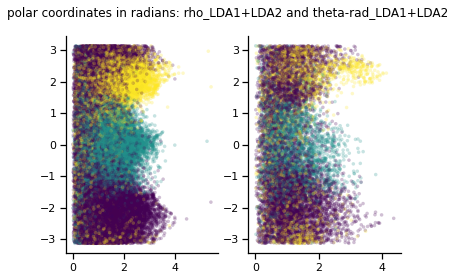

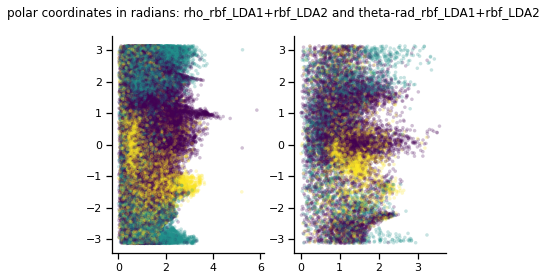

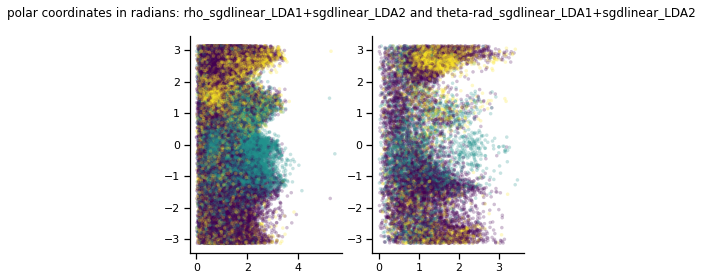

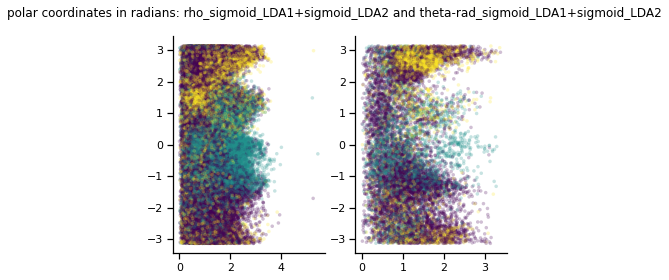

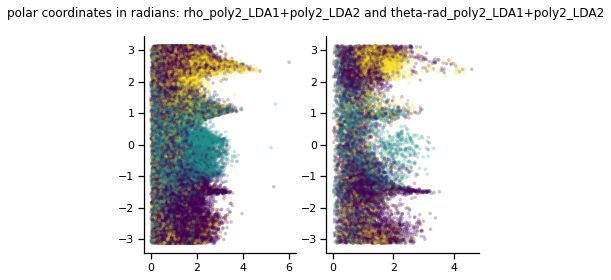

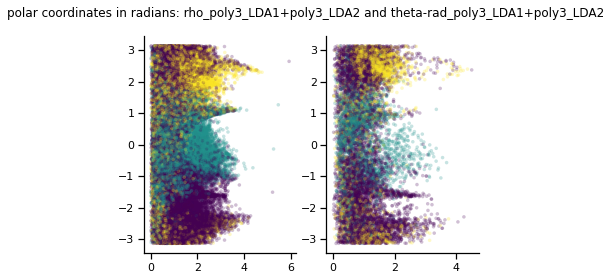

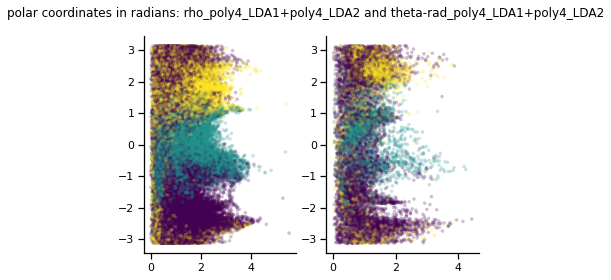

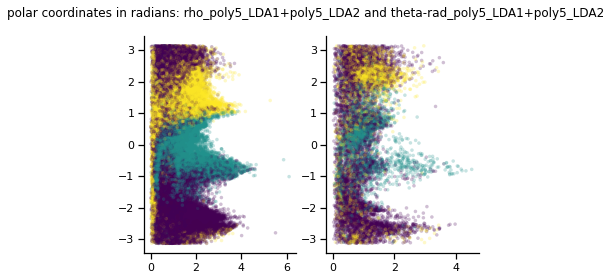

time: 6.83 s


In [25]:
def cartesian_to_polar(X: pd.DataFrame, col1: str, col2: str) -> pd.DataFrame:
    X[f"rho_{col1}+{col2}"] = hypot(X[col1], X[col2])
    X[f"theta-rad_{col1}+{col2}"] = arctan2(X[col2], X[col1])
    return X


for col1, col2 in doubles:
    X_train = cartesian_to_polar(X_train, col1, col2)
    X_test = cartesian_to_polar(X_test, col1, col2)
    plot2d(
        f"rho_{col1}+{col2}",
        f"theta-rad_{col1}+{col2}",
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="polar coordinates in radians",
    )

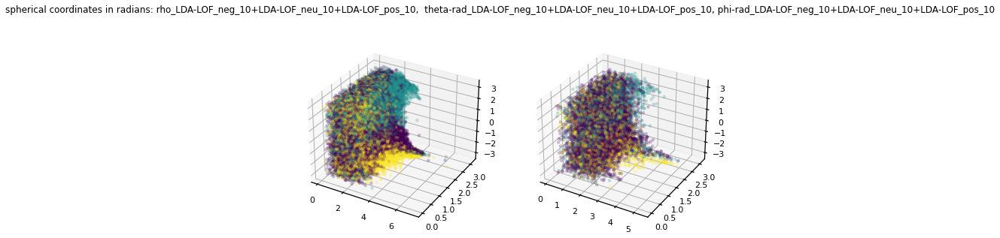

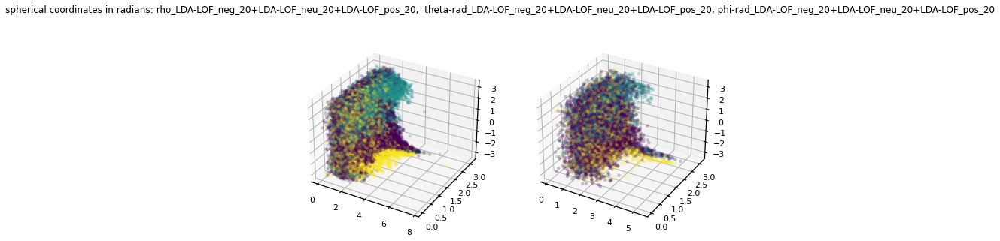

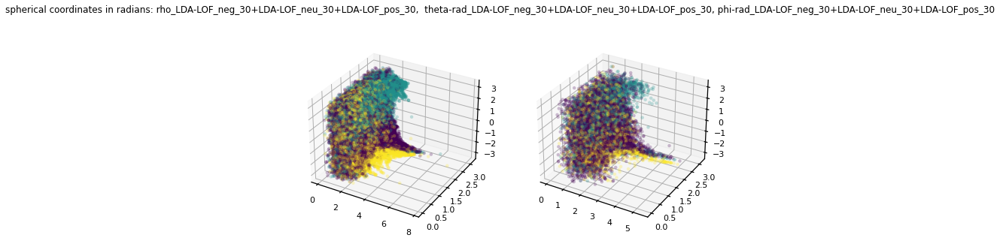

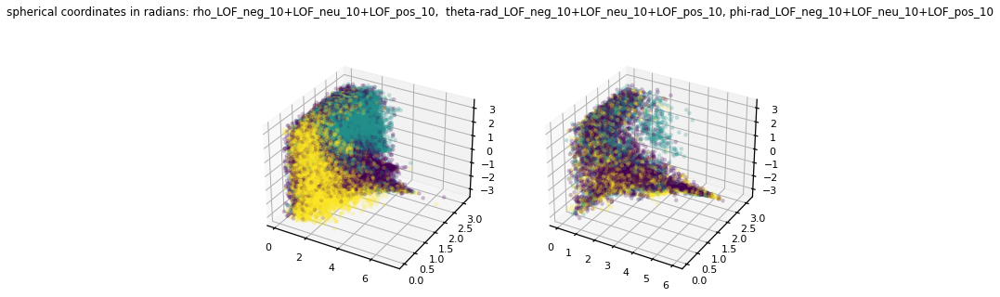

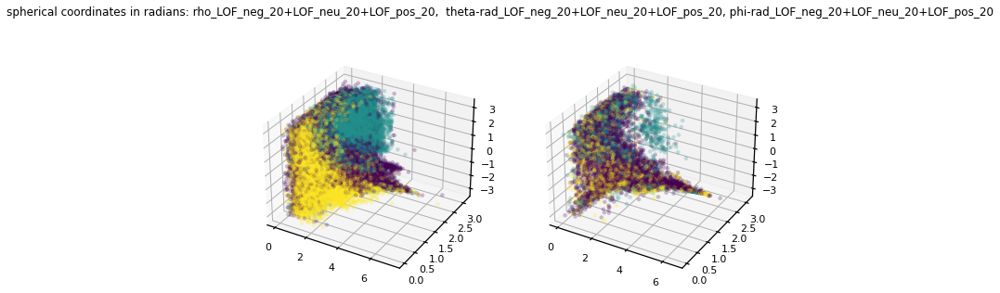

...

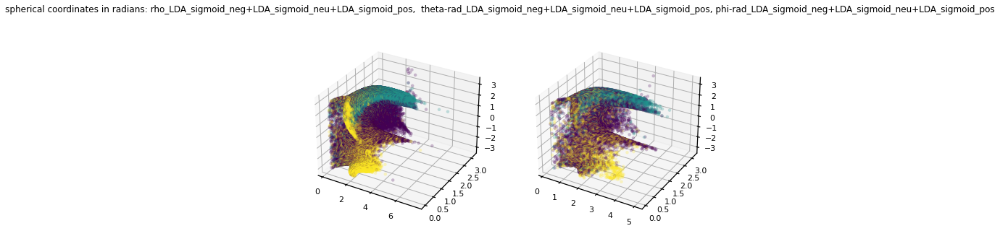

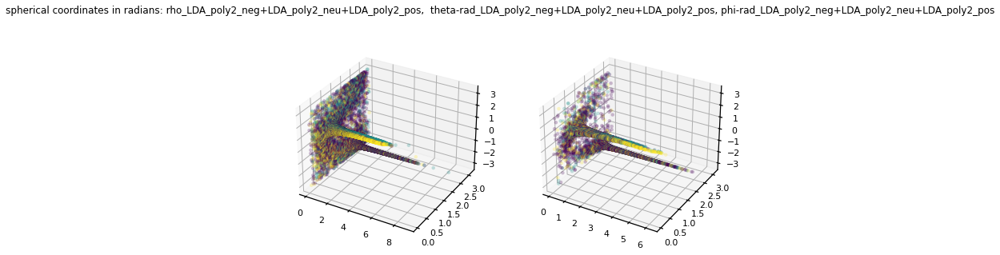

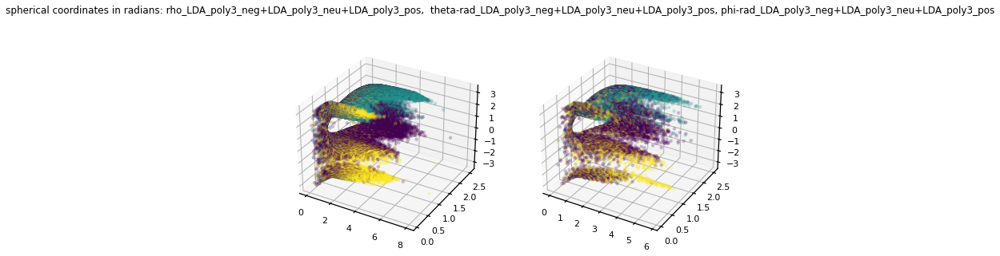

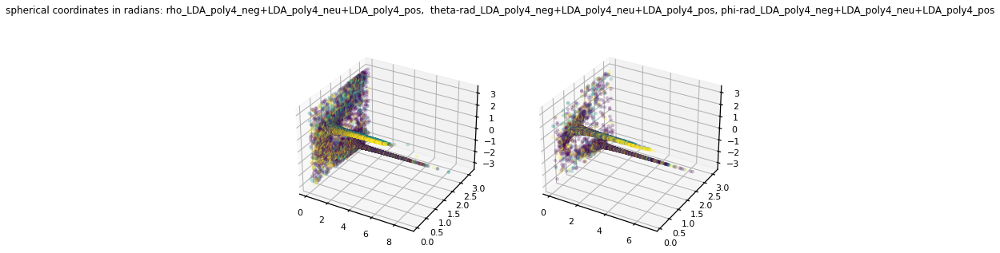

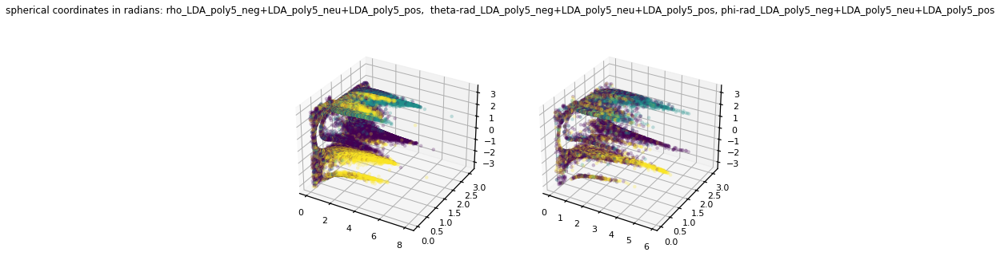

time: 24.1 s


In [26]:
def cartesian_to_spherical(
    X: pd.DataFrame, col1: str, col2: str, col3: str
) -> pd.DataFrame:
    combo = f"{col1}+{col2}+{col3}"
    x, y, z = X[col1], X[col2], X[col3]
    xy = x ** 2 + y ** 2
    X[f"rho_{combo}"] = np.sqrt(xy + z ** 2)
    X[f"theta-rad_{combo}"] = arctan2(np.sqrt(xy), z)
    X[f"phi-rad_{combo}"] = arctan2(y, x)
    return X


for col1, col2, col3 in triples:
    X_train = cartesian_to_spherical(X_train, col1, col2, col3)
    X_test = cartesian_to_spherical(X_test, col1, col2, col3)
    combo = f"{col1}+{col2}+{col3}"
    plot3d(
        f"rho_{combo}",
        f"theta-rad_{combo}",
        f"phi-rad_{combo}",
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="spherical coordinates in radians",
    )

In [27]:
score_models(
    X_train,
    y_train,
    X_test,
    y_test,
    features="QT-std+polar/spherical",
    select_features=True,
)

GaussianNB()
accuracy: 0.6037498147324737
balanced_accuracy: 0.39651855830090355
f1_weighted: 0.6103337942186144
geometric_mean: 0.594648966951743
auroc: 0.7658007308300263
GaussianNB()
accuracy: 0.5877427004594634
balanced_accuracy: 0.4140746652135963
f1_weighted: 0.5946084611707566
geometric_mean: 0.6023756101418442
auroc: 0.7732581215771991


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.630428338520824
balanced_accuracy: 0.33330249162767683
f1_weighted: 0.6122728916500326
geometric_mean: 0.4951811881387231
auroc: 0.7580457973266579


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6336149399733215
balanced_accuracy: 0.30229496266189393
f1_weighted: 0.6061963533599304
geometric_mean: 0.45417480223159573
auroc: 0.751942348462062
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6342819030680302
balanced_accuracy: 0.3142713730387709
f1_weighted: 0.6101860661747955
geometric_mean: 0.4706354376786077
auroc: 0.7542507236764671
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6496220542463317
balanced_accuracy: 0.31837800437809144
f1_weighted: 0.6281038183493749
geometric_mean: 0.4912003124759263
auroc: 0.7538676010661176
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.636060471320587
balanced_accuracy: 0.30137133287454887
f1_weighted: 0.6176329875481376
geometric_mean: 0.48321021021261346
auroc: 0.734525984525404
CalibratedClassifierC

The F1 may be the highest observed in this notebook. Accuracy higher than either subestimator. Balanced accuracy, geometric mean, and AUROC are surpassed by GNB.

Copied and pasted from above for reference:

Untransformed:
* GaussianNB()
  * accuracy: 0.6313917296576256
  * balanced_accuracy: 0.23665390690727175
  * f1_weighted: 0.5967478047199439
  * geometric_mean: 0.4267490208237378
  * auroc: 0.748253715448872
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6380613606047132
  * balanced_accuracy: 0.31155357350482027
  * f1_weighted: 0.6187821893238297
  * geometric_mean: 0.4935924357745123
  * auroc: 0.7575364007939785
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6490291981621461
  * balanced_accuracy: 0.333935968248291
  * *f1_weighted: 0.6293224816609382*
  * geometric_mean: 0.5051782933513195
  * auroc: 0.7535351670022706
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643761335084176

Yeo-Johnson + standardization:
* GaussianNB()
  * accuracy: 0.6279828071735586
  * balanced_accuracy: 0.33557440623570384
  * f1_weighted: 0.6196927921199264
  * geometric_mean: 0.5317238554271049
  * auroc: 0.761509535541956
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6378390395731436
  * balanced_accuracy: 0.3032168191448733
  * f1_weighted: 0.6132576883786681
  * geometric_mean: 0.4718492604944274
  * auroc: 0.7540975712505336
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6485104490884838
  * balanced_accuracy: 0.3260213584413257
  * f1_weighted: 0.6280982133193316
  * geometric_mean: 0.5003371788269403
  * auroc: 0.7542472903268659
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6473988439306358
  * balanced_accuracy: 0.27211697371593035
  * f1_weighted: 0.6096949010482753
  * geometric_mean: 0.4291473364989096
  * auroc: 0.7638133094910748

Quantile transformation:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * *balanced_accuracy: 0.3807113697404689*
  * f1_weighted: 0.6188166624329459
  * *geometric_mean: 0.5793319249372495*
  * *auroc: 0.7689886260571416*
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6362086853416333
  * balanced_accuracy: 0.3111206991081969
  * f1_weighted: 0.6137568454111832
  * geometric_mean: 0.4777317102111034
  * auroc: 0.7526013736609206
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462161025469437
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643721514738875

Quantile transformation + standardization:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * *balanced_accuracy: 0.3807113697404689*
  * f1_weighted: 0.6188166624329459
  * *geometric_mean: 0.5793319249372495*
  * *auroc: 0.7689886260571416*
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6377649325626205
  * balanced_accuracy: 0.3107895950308908
  * f1_weighted: 0.6142476458897491
  * geometric_mean: 0.4745047624620162
  * auroc: 0.7544060261187233
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462152933903449
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643860831160816
* VotingClassifier GaussianNB + RidgeClassifier
  * accuracy: 0.6492515191937157
  * balanced_accuracy: 0.34729595343407077
  * *f1_weighted: 0.6349070112093896*
  * geometric_mean: 0.527320943804727
  * auroc: 0.7593243529983406

Quantile transformation + standardization + polar/spherical:
* GaussianNB()
  * accuracy: 0.5988587520379428
  * **balanced_accuracy: 0.3991006044951968**
  * f1_weighted: 0.6061487398480797
  * **geometric_mean: 0.5970372119198112**
  * **auroc: 0.7690140821319031**
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6266488809841411
  * balanced_accuracy: 0.3391679608934142
  * f1_weighted: 0.6193402177236524
  * geometric_mean: 0.5331917984962715
  * auroc: 0.7619069204285421
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * *accuracy: 0.65236401363569*
  * balanced_accuracy: 0.3247012689295317
  * f1_weighted: 0.6289899950122293
  * geometric_mean: 0.49141687324723177
  * auroc: 0.7544744212727977
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6504372313620869
  * balanced_accuracy: 0.27878277011872493
  * f1_weighted: 0.6151235690166343
  * geometric_mean: 0.44158905936025894
  * auroc: 0.7642168587066522
* VotingClassifier GaussianNB + RidgeClassifier
  * **accuracy: 0.6532532977619683**
  * balanced_accuracy: 0.35626961199342105
  * **f1_weighted: 0.6393386940830721**
  * geometric_mean: 0.5336103032204443
  * auroc: 0.7663777576153494

Do the newly extracted polar/spherical coordinates need to be standardized too?

In [28]:
std_scaler = StandardScaler().fit(X_train)
feature_names = X_train.columns
X_train = pd.DataFrame(std_scaler.transform(X_train))
X_train.columns = feature_names
X_test = pd.DataFrame(std_scaler.transform(X_test))
X_test.columns = feature_names
del feature_names
del std_scaler
_ = gc_collect()

time: 330 ms


In [29]:
score_models(
    X_train,
    y_train,
    X_test,
    y_test,
    features="QT-std+polar/spherical-std",
    select_features=True,
)

GaussianNB()
accuracy: 0.6037498147324737
balanced_accuracy: 0.39651855830090355
f1_weighted: 0.6103337942186144
geometric_mean: 0.594648966951743
auroc: 0.7658007353431242
GaussianNB()
accuracy: 0.5903364458277753
balanced_accuracy: 0.41438658640969955
f1_weighted: 0.5971361236806157
geometric_mean: 0.6025667503654073
auroc: 0.7736917997877728


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6337631539943679
balanced_accuracy: 0.3012706918496982
f1_weighted: 0.6054443703521948
geometric_mean: 0.45300228033605955
auroc: 0.7427021628379746


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6310953016155328
balanced_accuracy: 0.306399994209556
f1_weighted: 0.6093845778126317
geometric_mean: 0.47532432070086467
auroc: 0.7491955605933351
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6306506595523936
balanced_accuracy: 0.3119875993488612
f1_weighted: 0.6095123161518117
geometric_mean: 0.4777868260325009
auroc: 0.7477424673138496
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6415443900993034
balanced_accuracy: 0.30922779242223275
f1_weighted: 0.6249522869648784
geometric_mean: 0.5039266857196132
auroc: 0.7534419716886107
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.624351563657922
balanced_accuracy: 0.28668886700769075
f1_weighted: 0.6080652110640876
geometric_mean: 0.48649166203143124
auroc: 0.7282625931245735
CalibratedClassifierC

Copied and pasted from above for reference:

Untransformed:
* GaussianNB()
  * accuracy: 0.6313917296576256
  * balanced_accuracy: 0.23665390690727175
  * f1_weighted: 0.5967478047199439
  * geometric_mean: 0.4267490208237378
  * auroc: 0.748253715448872
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6380613606047132
  * balanced_accuracy: 0.31155357350482027
  * f1_weighted: 0.6187821893238297
  * geometric_mean: 0.4935924357745123
  * auroc: 0.7575364007939785
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6490291981621461
  * balanced_accuracy: 0.333935968248291
  * *f1_weighted: 0.6293224816609382*
  * geometric_mean: 0.5051782933513195
  * auroc: 0.7535351670022706
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643761335084176

Yeo-Johnson + standardization:
* GaussianNB()
  * accuracy: 0.6279828071735586
  * balanced_accuracy: 0.33557440623570384
  * f1_weighted: 0.6196927921199264
  * geometric_mean: 0.5317238554271049
  * auroc: 0.761509535541956
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6378390395731436
  * balanced_accuracy: 0.3032168191448733
  * f1_weighted: 0.6132576883786681
  * geometric_mean: 0.4718492604944274
  * auroc: 0.7540975712505336
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6485104490884838
  * balanced_accuracy: 0.3260213584413257
  * f1_weighted: 0.6280982133193316
  * geometric_mean: 0.5003371788269403
  * auroc: 0.7542472903268659
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6473988439306358
  * balanced_accuracy: 0.27211697371593035
  * f1_weighted: 0.6096949010482753
  * geometric_mean: 0.4291473364989096
  * auroc: 0.7638133094910748

Quantile transformation:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * *balanced_accuracy: 0.3807113697404689*
  * f1_weighted: 0.6188166624329459
  * *geometric_mean: 0.5793319249372495*
  * *auroc: 0.7689886260571416*
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6362086853416333
  * balanced_accuracy: 0.3111206991081969
  * f1_weighted: 0.6137568454111832
  * geometric_mean: 0.4777317102111034
  * auroc: 0.7526013736609206
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462161025469437
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643721514738875

Quantile transformation + standardization:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * *balanced_accuracy: 0.3807113697404689*
  * f1_weighted: 0.6188166624329459
  * *geometric_mean: 0.5793319249372495*
  * auroc: 0.7689886260571416
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6377649325626205
  * balanced_accuracy: 0.3107895950308908
  * f1_weighted: 0.6142476458897491
  * geometric_mean: 0.4745047624620162
  * auroc: 0.7544060261187233
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462152933903449
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643860831160816
* VotingClassifier GaussianNB + RidgeClassifier
  * accuracy: 0.6492515191937157
  * balanced_accuracy: 0.34729595343407077
  * *f1_weighted: 0.6349070112093896*
  * geometric_mean: 0.527320943804727
  * auroc: 0.7593243529983406

Quantile transformation + standardization + polar/spherical:
* GaussianNB()
  * accuracy: 0.5988587520379428
  * **balanced_accuracy: 0.3991006044951968**
  * f1_weighted: 0.6061487398480797
  * **geometric_mean: 0.5970372119198112**
  * *auroc: 0.7690140821319031*
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6266488809841411
  * balanced_accuracy: 0.3391679608934142
  * f1_weighted: 0.6193402177236524
  * geometric_mean: 0.5331917984962715
  * auroc: 0.7619069204285421
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * *accuracy: 0.65236401363569*
  * balanced_accuracy: 0.3247012689295317
  * f1_weighted: 0.6289899950122293
  * geometric_mean: 0.49141687324723177
  * auroc: 0.7544744212727977
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6504372313620869
  * balanced_accuracy: 0.27878277011872493
  * f1_weighted: 0.6151235690166343
  * geometric_mean: 0.44158905936025894
  * auroc: 0.7642168587066522
* VotingClassifier GaussianNB + RidgeClassifier
  * **accuracy: 0.6532532977619683**
  * balanced_accuracy: 0.35626961199342105
  * **f1_weighted: 0.6393386940830721**
  * geometric_mean: 0.5336103032204443
  * auroc: 0.7663777576153494

Quantile transformation + standardization + polar/spherical + standardization:
* GaussianNB()
  * accuracy: 0.5988587520379428
  * **balanced_accuracy: 0.3991006044951968**
  * f1_weighted: 0.6061487398480797
  * **geometric_mean: 0.5970372119198112**
  * **auroc: 0.7690222241030831**
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6432488513413369
  * balanced_accuracy: 0.3110277735513372
  * f1_weighted: 0.6166024853323233
  * geometric_mean: 0.4666325431268902
  * auroc: 0.7563539191471071
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * *accuracy: 0.65236401363569*
  * balanced_accuracy: 0.3247012689295317
  * f1_weighted: 0.6289899950122293
  * geometric_mean: 0.49141687324723177
  * auroc: 0.7544738205236283
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6504372313620869
  * balanced_accuracy: 0.27878277011872493
  * f1_weighted: 0.6151235690166343
  * geometric_mean: 0.44158905936025894
  * auroc: 0.764216575111288
* VotingClassifier GaussianNB + RidgeClassifier
  * **accuracy: 0.6532532977619683**
  * balanced_accuracy: 0.35626961199342105
  * **f1_weighted: 0.6393386940830721**
  * geometric_mean: 0.5336103032204443
  * auroc: 0.7663775962613282

We should also see what happens if we use the PowerTransformer instead before adding new coordinates.

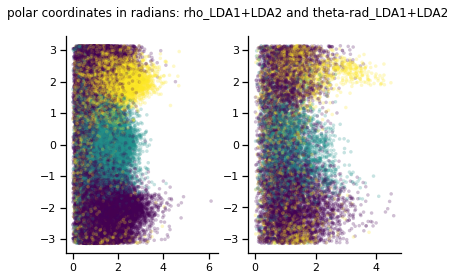

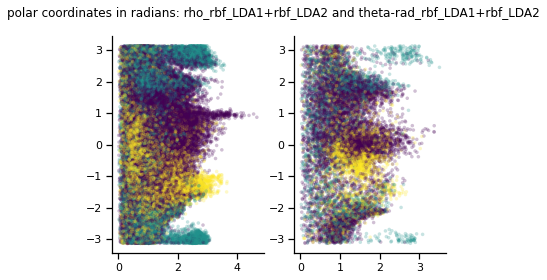

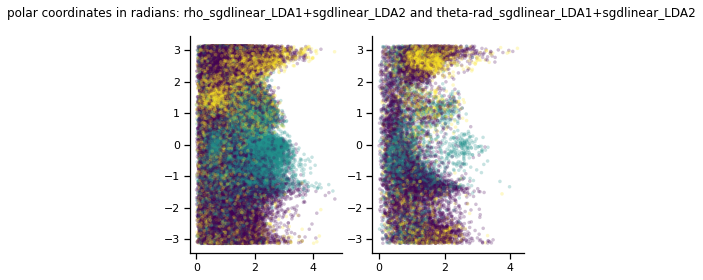

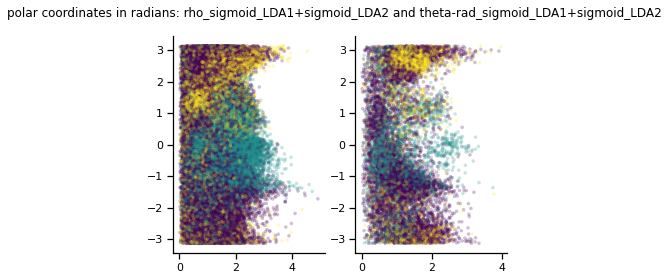

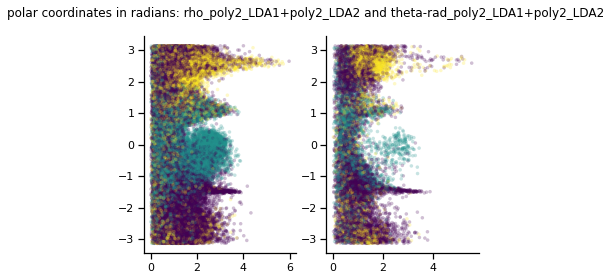

...

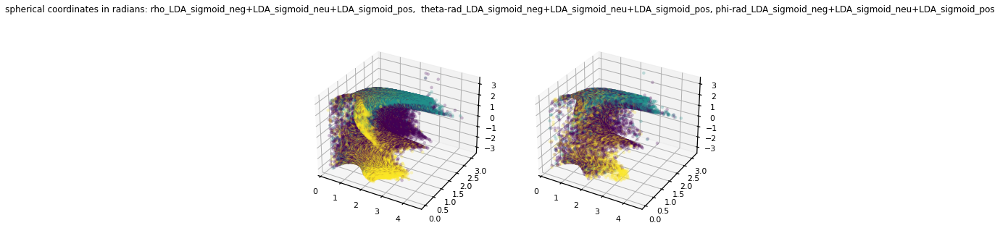

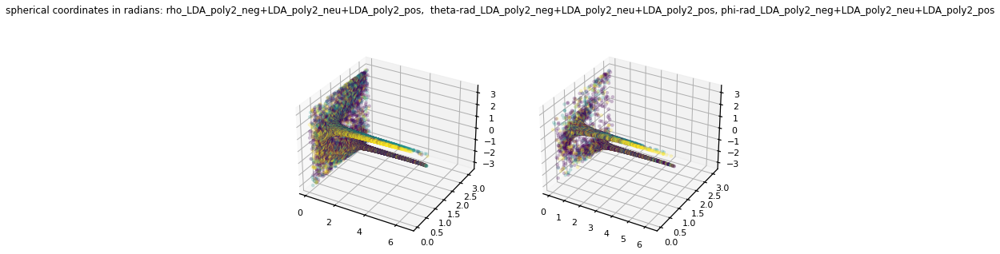

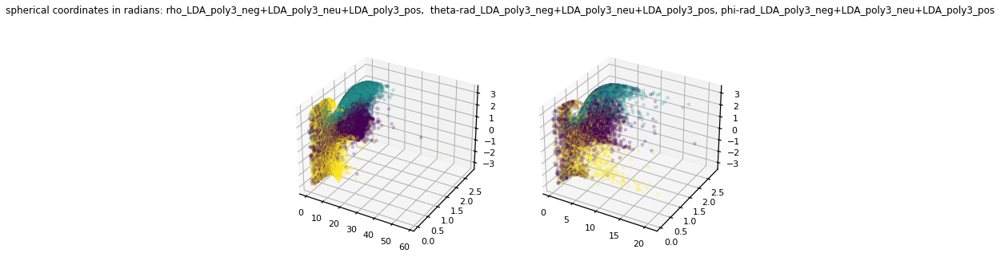

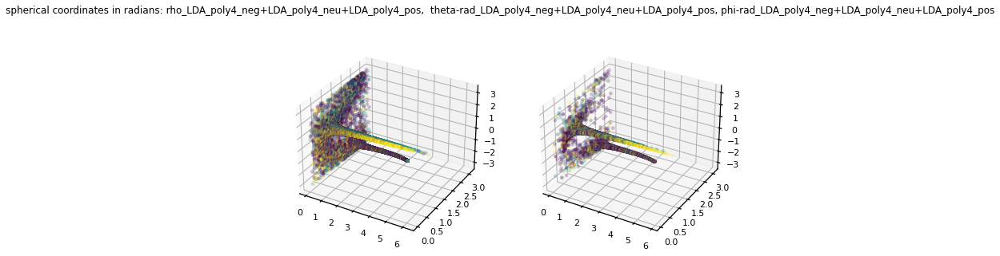

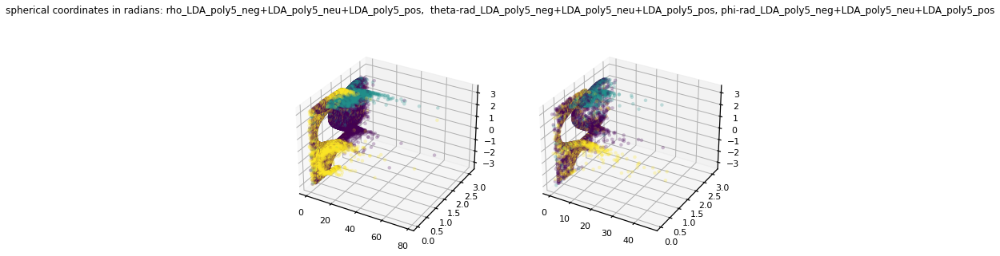

time: 38.8 s


In [30]:
X_train, y_train = read_data("train")
X_test, y_test = read_data("test")

power_transformer = PowerTransformer().fit(X_train)
feature_names = X_train.columns
X_train = pd.DataFrame(power_transformer.transform(X_train))
X_train.columns = feature_names
X_test = pd.DataFrame(power_transformer.transform(X_test))
X_test.columns = feature_names
del feature_names
del power_transformer
_ = gc_collect()

for col1, col2 in doubles:
    X_train = cartesian_to_polar(X_train, col1, col2)
    X_test = cartesian_to_polar(X_test, col1, col2)
    combo = f"{col1}+{col2}"
    plot2d(
        f"rho_{combo}",
        f"theta-rad_{combo}",
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="polar coordinates in radians",
    )

for col1, col2, col3 in triples:
    X_train = cartesian_to_spherical(X_train, col1, col2, col3)
    X_test = cartesian_to_spherical(X_test, col1, col2, col3)
    combo = f"{col1}+{col2}+{col3}"
    plot3d(
        f"rho_{combo}",
        f"theta-rad_{combo}",
        f"phi-rad_{combo}",
        X_train,
        y_train,
        X_test,
        y_test,
        suptitle="spherical coordinates in radians",
    )

In [31]:
score_models(
    X_train,
    y_train,
    X_test,
    y_test,
    features="YJ-std+polar/spherical",
    select_features=True,
)

GaussianNB()
accuracy: 0.6195346079739144
balanced_accuracy: 0.3604107977755197
f1_weighted: 0.6189660082785448
geometric_mean: 0.5623899619589877
auroc: 0.7610023071781253
GaussianNB()
accuracy: 0.5844078849859197
balanced_accuracy: 0.4064875150986022
f1_weighted: 0.5908494778469768
geometric_mean: 0.5957631483549249
auroc: 0.7683764585284681


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6217578182896102
balanced_accuracy: 0.2958463111711003
f1_weighted: 0.6053304017759796
geometric_mean: 0.4886861581533915
auroc: 0.7494683626151893


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.5861123462279532
balanced_accuracy: 0.2045498994732147
f1_weighted: 0.5538502837700832
geometric_mean: 0.38193909149857425
auroc: 0.7166103257274161
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6014524974062546
balanced_accuracy: 0.19805925397147517
f1_weighted: 0.5565580691969605
geometric_mean: 0.34638309590496674
auroc: 0.7080674519002694
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.5864087742700459
balanced_accuracy: 0.14359793787432093
f1_weighted: 0.5411719262486777
geometric_mean: 0.3436534408681626
auroc: 0.6859444213551414
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.621683711279087
balanced_accuracy: 0.21563379478197056
f1_weighted: 0.5762900978288874
geometric_mean: 0.3760087545391386
auroc: 0.7157451407035323
CalibratedClassifie

Let's standardize one more time just to be safe.

In [32]:
std_scaler = StandardScaler().fit(X_train)
feature_names = X_train.columns
X_train = pd.DataFrame(std_scaler.transform(X_train))
X_train.columns = feature_names
X_test = pd.DataFrame(std_scaler.transform(X_test))
X_test.columns = feature_names
del feature_names
del std_scaler
_ = gc_collect()

time: 297 ms


In [33]:
score_models(X_train, y_train, X_test, y_test, features="YJ-std+polar/spherical-std")

GaussianNB()
accuracy: 0.6195346079739144
balanced_accuracy: 0.3604107977755197
f1_weighted: 0.6189660082785448
geometric_mean: 0.5623899619589877
auroc: 0.7610022805210443


C:\Users\michen\miniconda3\envs\capstone_pyspark_38\lib\site-packages\daal4py\sklearn\linear_model\logistic_path.py:432: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(n_jobs=1, random_state=2021)
accuracy: 0.6325774418259967
balanced_accuracy: 0.2792780878928274
f1_weighted: 0.5999729654053343
geometric_mean: 0.4305909592183848
auroc: 0.747615796417185
CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021),
                       n_jobs=-1)
accuracy: 0.6469542018674966
balanced_accuracy: 0.3223249499376033
f1_weighted: 0.6268559768087667
geometric_mean: 0.4989271241904256
auroc: 0.7573629205649551
CalibratedClassifierCV(base_estimator=SVC(random_state=2021), n_jobs=-1)
accuracy: 0.644805098562324
balanced_accuracy: 0.2722218701314912
f1_weighted: 0.6055061716713213
geometric_mean: 0.4207949468571156
auroc: 0.755188595627561
RandomForestClassifier(n_jobs=-1, random_state=2021)
accuracy: 0.648214021046391
balanced_accuracy: 0.27924730299393413
f1_weighted: 0.6136003887340119
geometric_mean: 0.4413992387059276
auroc: 0.7691109358566737
VotingClassifier(estimators=[('GNB',
                              CalibratedClas

Copied and pasted from above for reference:

Untransformed:
* GaussianNB()
  * accuracy: 0.6313917296576256
  * balanced_accuracy: 0.23665390690727175
  * f1_weighted: 0.5967478047199439
  * geometric_mean: 0.4267490208237378
  * auroc: 0.748253715448872
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6380613606047132
  * balanced_accuracy: 0.31155357350482027
  * f1_weighted: 0.6187821893238297
  * geometric_mean: 0.4935924357745123
  * auroc: 0.7575364007939785
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6490291981621461
  * balanced_accuracy: 0.333935968248291
  * *f1_weighted: 0.6293224816609382*
  * geometric_mean: 0.5051782933513195
  * auroc: 0.7535351670022706
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643761335084176

Yeo-Johnson + standardization:
* GaussianNB()
  * accuracy: 0.6279828071735586
  * balanced_accuracy: 0.33557440623570384
  * f1_weighted: 0.6196927921199264
  * geometric_mean: 0.5317238554271049
  * auroc: 0.761509535541956
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6378390395731436
  * balanced_accuracy: 0.3032168191448733
  * f1_weighted: 0.6132576883786681
  * geometric_mean: 0.4718492604944274
  * auroc: 0.7540975712505336
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6485104490884838
  * balanced_accuracy: 0.3260213584413257
  * f1_weighted: 0.6280982133193316
  * geometric_mean: 0.5003371788269403
  * auroc: 0.7542472903268659
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6473988439306358
  * balanced_accuracy: 0.27211697371593035
  * f1_weighted: 0.6096949010482753
  * geometric_mean: 0.4291473364989096
  * auroc: 0.7638133094910748

Quantile transformation:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * *balanced_accuracy: 0.3807113697404689*
  * f1_weighted: 0.6188166624329459
  * *geometric_mean: 0.5793319249372495*
  * *auroc: 0.7689886260571416*
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6362086853416333
  * balanced_accuracy: 0.3111206991081969
  * f1_weighted: 0.6137568454111832
  * geometric_mean: 0.4777317102111034
  * auroc: 0.7526013736609206
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462161025469437
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643721514738875

Quantile transformation + standardization:
* GaussianNB()
  * accuracy: 0.6161997925003705
  * *balanced_accuracy: 0.3807113697404689*
  * f1_weighted: 0.6188166624329459
  * *geometric_mean: 0.5793319249372495*
  * auroc: 0.7689886260571416
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6377649325626205
  * balanced_accuracy: 0.3107895950308908
  * f1_weighted: 0.6142476458897491
  * geometric_mean: 0.4745047624620162
  * auroc: 0.7544060261187233
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * accuracy: 0.6480658070253446
  * balanced_accuracy: 0.32889937340178066
  * f1_weighted: 0.6276478023448933
  * geometric_mean: 0.49942472132690624
  * auroc: 0.7462152933903449
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * *accuracy: 0.6495479472358086*
  * balanced_accuracy: 0.2775304873037968
  * f1_weighted: 0.6125207798959956
  * geometric_mean: 0.43384433066713696
  * auroc: 0.7643860831160816
* VotingClassifier GaussianNB + RidgeClassifier
  * accuracy: 0.6492515191937157
  * balanced_accuracy: 0.34729595343407077
  * *f1_weighted: 0.6349070112093896*
  * geometric_mean: 0.527320943804727
  * auroc: 0.7593243529983406

Quantile transformation + standardization + polar/spherical:
* GaussianNB()
  * accuracy: 0.5988587520379428
  * **balanced_accuracy: 0.3991006044951968**
  * f1_weighted: 0.6061487398480797
  * **geometric_mean: 0.5970372119198112**
  * *auroc: 0.7690140821319031*
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6266488809841411
  * balanced_accuracy: 0.3391679608934142
  * f1_weighted: 0.6193402177236524
  * geometric_mean: 0.5331917984962715
  * auroc: 0.7619069204285421
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * *accuracy: 0.65236401363569*
  * balanced_accuracy: 0.3247012689295317
  * f1_weighted: 0.6289899950122293
  * geometric_mean: 0.49141687324723177
  * auroc: 0.7544744212727977
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6504372313620869
  * balanced_accuracy: 0.27878277011872493
  * f1_weighted: 0.6151235690166343
  * geometric_mean: 0.44158905936025894
  * auroc: 0.7642168587066522
* VotingClassifier GaussianNB + RidgeClassifier
  * **accuracy: 0.6532532977619683**
  * balanced_accuracy: 0.35626961199342105
  * **f1_weighted: 0.6393386940830721**
  * geometric_mean: 0.5336103032204443
  * auroc: 0.7663777576153494

Quantile transformation + standardization + polar/spherical + standardization:
* GaussianNB()
  * accuracy: 0.5988587520379428
  * **balanced_accuracy: 0.3991006044951968**
  * f1_weighted: 0.6061487398480797
  * **geometric_mean: 0.5970372119198112**
  * **auroc: 0.7690222241030831**
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6432488513413369
  * balanced_accuracy: 0.3110277735513372
  * f1_weighted: 0.6166024853323233
  * geometric_mean: 0.4666325431268902
  * auroc: 0.7563539191471071
* CalibratedClassifierCV(base_estimator=RidgeClassifier(random_state=2021), n_jobs=-1)
  * *accuracy: 0.65236401363569*
  * balanced_accuracy: 0.3247012689295317
  * f1_weighted: 0.6289899950122293
  * geometric_mean: 0.49141687324723177
  * auroc: 0.7544738205236283
* RandomForestClassifier(n_jobs=-1, random_state=2021)
  * accuracy: 0.6504372313620869
  * balanced_accuracy: 0.27878277011872493
  * f1_weighted: 0.6151235690166343
  * geometric_mean: 0.44158905936025894
  * auroc: 0.764216575111288
* VotingClassifier GaussianNB + RidgeClassifier
  * **accuracy: 0.6532532977619683**
  * balanced_accuracy: 0.35626961199342105
  * **f1_weighted: 0.6393386940830721**
  * geometric_mean: 0.5336103032204443
  * auroc: 0.7663775962613282

Yeo-Johnson + standardization + polar/spherical:
* GaussianNB()
  * accuracy: 0.6202015710686231
  * balanced_accuracy: 0.3672237827138209
  * f1_weighted: 0.6202100212075554
  * geometric_mean: 0.5673695076937042
  * auroc: 0.7634577961347448
* LogisticRegression(n_jobs=1, random_state=2021)
  * accuracy: 0.6341336890469839
  * balanced_accuracy: 0.2753017700505132
  * f1_weighted: 0.6007778675203372
  * geometric_mean: 0.43073808834187793
  * auroc: 0.7483526663406068

Yeo-Johnson + standardization + polar/spherical + standardization:


In [34]:
results_df = pd.DataFrame(results).sort_values(
    by=[
        "accuracy",
        "adjusted balanced accuracy",
        "F1 weighted",
        "geometric mean",
        "AUROC",
    ],
    ascending=False,
)
results_df
_ = gc_collect()

,features,model,accuracy,adjusted balanced accuracy,F1 weighted,geometric mean,AUROC
103,YJ-std+polar/spherical-std,"VotingClassifier(estimators=[('GNB',\n ...",0.657255,0.323576,0.634063,0.497203,0.773137
61,selected_QT-std+polar/spherical,CalibratedClassifierCV(base_estimator=RidgeCla...,0.649622,0.318378,0.628104,0.491200,0.753868
102,YJ-std+polar/spherical-std,"RandomForestClassifier(n_jobs=-1, random_state...",0.648214,0.279247,0.613600,0.441399,0.769111
100,YJ-std+polar/spherical-std,CalibratedClassifierCV(base_estimator=RidgeCla...,0.646954,0.322325,0.626856,0.498927,0.757363
4,no transforms,CalibratedClassifierCV(base_estimator=RidgeCla...,0.646435,0.333757,0.628735,0.509795,0.766353
...,...,...,...,...,...,...,...
89,selected_YJ-std+polar/spherical,CalibratedClassifierCV(base_estimator=RidgeCla...,0.586409,0.143598,0.541172,0.343653,0.685944
87,selected_YJ-std+polar/spherical,"LogisticRegression(n_jobs=1, random_state=2021)",0.586112,0.204550,0.553850,0.381939,0.716610
85,selected_YJ-std+polar/spherical,GaussianNB(),0.584408,0.406488,0.590849,0.595763,0.768376
92,YJ-std+polar/spherical,"RandomForestClassifier(n_jobs=-1, random_state...",0.573959,0.082259,0.500013,0.205364,0.562091


time: 377 ms


In [35]:
results_df.sort_values(by="adjusted balanced accuracy", ascending=False)
_ = gc_collect()

,features,model,accuracy,adjusted balanced accuracy,F1 weighted,geometric mean,AUROC
71,selected_QT-std+polar/spherical-std,GaussianNB(),0.590336,0.414387,0.597136,0.602567,0.773692
57,selected_QT-std+polar/spherical,GaussianNB(),0.587743,0.414075,0.594608,0.602376,0.773258
85,selected_YJ-std+polar/spherical,GaussianNB(),0.584408,0.406488,0.590849,0.595763,0.768376
56,QT-std+polar/spherical,GaussianNB(),0.603750,0.396519,0.610334,0.594649,0.765801
70,QT-std+polar/spherical-std,GaussianNB(),0.603750,0.396519,0.610334,0.594649,0.765801
...,...,...,...,...,...,...,...
91,selected_YJ-std+polar/spherical,CalibratedClassifierCV(base_estimator=SVC(rand...,0.590485,0.074499,0.490977,0.105908,0.574379
94,YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.589595,0.073332,0.489325,0.052222,0.612186
95,selected_YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.589595,0.073332,0.489325,0.052222,0.612186
96,YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.588780,0.072848,0.488706,0.000000,0.609877


time: 155 ms


In [36]:
results_df.sort_values(by="F1 weighted", ascending=False)
_ = gc_collect()

,features,model,accuracy,adjusted balanced accuracy,F1 weighted,geometric mean,AUROC
103,YJ-std+polar/spherical-std,"VotingClassifier(estimators=[('GNB',\n ...",0.657255,0.323576,0.634063,0.497203,0.773137
4,no transforms,CalibratedClassifierCV(base_estimator=RidgeCla...,0.646435,0.333757,0.628735,0.509795,0.766353
104,YJ-std+polar/spherical-std,"VotingClassifier(estimators=[('GNB',\n ...",0.644657,0.325846,0.628131,0.511543,0.761764
61,selected_QT-std+polar/spherical,CalibratedClassifierCV(base_estimator=RidgeCla...,0.649622,0.318378,0.628104,0.491200,0.753868
1,selected_no transforms,GaussianNB(),0.627094,0.371049,0.627289,0.570131,0.770179
...,...,...,...,...,...,...,...
91,selected_YJ-std+polar/spherical,CalibratedClassifierCV(base_estimator=SVC(rand...,0.590485,0.074499,0.490977,0.105908,0.574379
95,selected_YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.589595,0.073332,0.489325,0.052222,0.612186
94,YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.589595,0.073332,0.489325,0.052222,0.612186
97,selected_YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.588780,0.072848,0.488706,0.000000,0.609877


time: 122 ms


In [37]:
results_df.sort_values(by="geometric mean", ascending=False)
_ = gc_collect()

,features,model,accuracy,adjusted balanced accuracy,F1 weighted,geometric mean,AUROC
71,selected_QT-std+polar/spherical-std,GaussianNB(),0.590336,0.414387,0.597136,0.602567,0.773692
57,selected_QT-std+polar/spherical,GaussianNB(),0.587743,0.414075,0.594608,0.602376,0.773258
85,selected_YJ-std+polar/spherical,GaussianNB(),0.584408,0.406488,0.590849,0.595763,0.768376
70,QT-std+polar/spherical-std,GaussianNB(),0.603750,0.396519,0.610334,0.594649,0.765801
56,QT-std+polar/spherical,GaussianNB(),0.603750,0.396519,0.610334,0.594649,0.765801
...,...,...,...,...,...,...,...
51,selected_QT-std,"RandomForestClassifier(n_jobs=-1, random_state...",0.617830,0.231702,0.543632,0.000000,0.626085
64,QT-std+polar/spherical,"RandomForestClassifier(n_jobs=-1, random_state...",0.617830,0.231702,0.543632,0.000000,0.626085
65,selected_QT-std+polar/spherical,"RandomForestClassifier(n_jobs=-1, random_state...",0.617830,0.231702,0.543632,0.000000,0.626085
78,QT-std+polar/spherical-std,"RandomForestClassifier(n_jobs=-1, random_state...",0.617830,0.231702,0.543632,0.000000,0.626085


time: 136 ms


In [38]:
results_df.sort_values(by="AUROC", ascending=False)
_ = gc_collect()

,features,model,accuracy,adjusted balanced accuracy,F1 weighted,geometric mean,AUROC
71,selected_QT-std+polar/spherical-std,GaussianNB(),0.590336,0.414387,0.597136,0.602567,0.773692
57,selected_QT-std+polar/spherical,GaussianNB(),0.587743,0.414075,0.594608,0.602376,0.773258
103,YJ-std+polar/spherical-std,"VotingClassifier(estimators=[('GNB',\n ...",0.657255,0.323576,0.634063,0.497203,0.773137
29,selected_QT,GaussianNB(),0.624352,0.392605,0.625096,0.582343,0.772257
43,selected_QT-std,GaussianNB(),0.624352,0.392605,0.625096,0.582343,0.772257
...,...,...,...,...,...,...,...
97,selected_YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.588780,0.072848,0.488706,0.000000,0.609877
96,YJ-std+polar/spherical,"VotingClassifier(estimators=[('GNB',\n ...",0.588780,0.072848,0.488706,0.000000,0.609877
91,selected_YJ-std+polar/spherical,CalibratedClassifierCV(base_estimator=SVC(rand...,0.590485,0.074499,0.490977,0.105908,0.574379
92,YJ-std+polar/spherical,"RandomForestClassifier(n_jobs=-1, random_state...",0.573959,0.082259,0.500013,0.205364,0.562091


time: 137 ms


In [39]:
print(f"Time elapsed since notebook_begin_time: {time() - notebook_begin_time} s")
_ = gc_collect()

Time elapsed since notebook_begin_time: 4030.580836057663 s
time: 108 ms


# Discussion

Note: A lot of the markdown above may not be accurate as they are artifacts of a previous run. The reader should refer to the final `results_df`.

Some of these features are useful. Feature selection should be incorporated into the pipeline.

The highest-order polynomial kernel features are probably overfit.

[^top](#Contents)